<img src="OC.png" width="50" height="50" align="left">    

***

<center> <font size="6"> <span style='color:Blue'> P7: Implémentez un modèle de scoring </span></font> </center>  

***

<font size="3"> <span style="font-size: 1.5em" > **Partie 2 - 1/2: Modélisation** </span> </font> 

**Contexte**  
**Prêt à dépenser** est une société financière qui propose des crédits à la consommation pour des personnes ayant peu ou pas du tout d'historique de prêt.
<img src="pretadepenser.png" width="200" height="200">
**Mission**   
* Construire un modèle de scoring qui donnera une prédiction sur la probabilité de faillite d'un client de façon automatique.
* Construire un dashboard interactif à destination des gestionnaires de la relation client permettant d'interpréter les prédictions faites par le modèle, et d’améliorer la connaissance client des chargés de relation client.
* Mettre en production le modèle de scoring de prédiction à l’aide d’une API, ainsi que le dashboard interactif qui appelle l’API pour les prédictions.

Dans ce notebook, nous allons:
* Résoudre le problème de désiquilibre entre les classes.
* Implémenter un modèle de machine learning
* Chercher les meilleurs hyperparamètres par gridsearchCV
* Comparer les performances des modèles
* Sélectionner le meilleur modèle
* Interpréter le modèle globalement et localement 

# Importation des données et des librairies Python pour DS

In [88]:
# ------------------------------------------
# Projet : Implémenter un modèle de scoring
# Données: https://www.kaggle.com/c/home-credit-default-risk/data
# Auteur : Rim BAHROUN
# Date: Avril 2023
# OpenClassrooms
# -------------------------------------------
# importation des librairies Python pour DS
# -------------------------------------------
import os
import csv
import numpy as np
import pandas as pd
import re
import gc
import time
import timeit
from contextlib import contextmanager
from sklearn.preprocessing import StandardScaler

import lightgbm as lgb
from sklearn.metrics import make_scorer, f1_score, fbeta_score, roc_auc_score, roc_curve
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix, classification_report
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
from pylab import rcParams
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import mlflow

from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from lightgbm import LGBMClassifier
from sklearn.linear_model import SGDClassifier

from lime.lime_tabular import LimeTabularExplainer
import shap
import random

In [2]:
import sys
print(sys.executable)

C:\ProgramData\Anaconda3\python.exe


In [18]:
%matplotlib inline
np.random.seed(27)
rcParams['figure.figsize'] = 10, 6
warnings.filterwarnings('ignore')
sns.set(style="darkgrid")

In [4]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)

In [2]:
train_df = pd.read_csv('data/traited/df_train_35.csv')

In [6]:
train_df.head()

,EXT_SOURCE_2,PREV_DAYS_DECISION_MEAN,BURO_MONTHS_BALANCE_SIZE_MEAN,DAYS_REGISTRATION,PREV_NAME_YIELD_GROUP_low_normal_MEAN,PREV_NAME_YIELD_GROUP_high_MEAN,REGION_POPULATION_RELATIVE,PREV_NAME_PAYMENT_TYPE_Cashthroughthebank_MEAN,BURO_DAYS_CREDIT_MAX,POS_MONTHS_BALANCE_MEAN,BURO_CREDIT_TYPE_Creditcard_MEAN,CLOSED_DAYS_CREDIT_MAX,BURO_STATUS_0_MEAN_MEAN,HOUR_APPR_PROCESS_START,PREV_NAME_PRODUCT_TYPE_XNA_MEAN,PREV_NAME_SELLER_INDUSTRY_Consumerelectronics_MEAN,CC_AMT_CREDIT_LIMIT_ACTUAL_SUM,PREV_NAME_TYPE_SUITE_nan_MEAN,CLOSED_DAYS_CREDIT_MEAN,ACTIVE_DAYS_CREDIT_MIN,BURO_DAYS_CREDIT_MIN,EXT_SOURCE_3,EXT_SOURCE_1,BURO_DAYS_CREDIT_MEAN,DAYS_BIRTH,BURO_CREDIT_ACTIVE_Active_MEAN,ACTIVE_DAYS_CREDIT_MAX,PREV_NAME_CONTRACT_STATUS_Approved_MEAN,DAYS_LAST_PHONE_CHANGE,REFUSED_DAYS_DECISION_MAX,ACTIVE_DAYS_CREDIT_MEAN,PREV_DAYS_DECISION_MIN,DAYS_ID_PUBLISH,TARGET,SK_ID_CURR
0,0.262949,-606.000000,13.75,-3648.0,1.000000,0.000000,0.018801,0.000000,-103.0,-10.000000,0.5,-476.0,0.406960,10,1.000000,0.000000,3960000.0,1.000000,-974.500000,-1042.0,-1437.0,0.139376,0.083037,-874.000000,-9461,0.250,-103.0,1.000000,-1134.0,-396.0,-572.500000,-606.0,-2120,1.0,100002
1,0.622246,-1305.000000,24.75,-1186.0,0.333333,0.000000,0.003541,0.666667,-606.0,-43.785714,0.5,-775.0,0.436423,11,0.666667,0.333333,3960000.0,0.000000,-1665.666667,-606.0,-2586.0,0.535276,0.311267,-1400.750000,-16765,0.250,-606.0,1.000000,-828.0,-396.0,-606.000000,-2341.0,-291,0.0,100003
2,0.555912,-815.000000,24.75,-4260.0,0.000000,0.000000,0.010032,1.000000,-408.0,-25.500000,0.0,-408.0,0.436423,9,1.000000,0.000000,3960000.0,0.000000,-867.000000,-764.0,-1326.0,0.729567,0.505998,-867.000000,-19046,0.000,-258.0,1.000000,-815.0,-396.0,-537.309524,-815.0,-2531,0.0,100004
3,0.650442,-272.444444,24.75,-9833.0,0.222222,0.222222,0.008019,0.444444,-300.0,-9.619048,0.2,-729.0,0.436423,17,0.555556,0.111111,1620000.0,0.555556,-1366.555556,-764.0,-1827.0,0.535276,0.505998,-1050.571429,-19005,0.375,-258.0,0.555556,-617.0,-181.0,-537.309524,-617.0,-2437,0.0,100006
4,0.322738,-1222.833333,24.75,-4311.0,0.000000,0.500000,0.028663,0.833333,-1149.0,-33.636364,0.0,-1149.0,0.436423,11,0.333333,0.500000,3960000.0,0.333333,-1149.000000,-764.0,-1149.0,0.535276,0.505998,-1149.000000,-19932,0.000,-258.0,1.000000,-1106.0,-396.0,-537.309524,-2357.0,-3458,0.0,100007


In [7]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307507 entries, 0 to 307506
Data columns (total 35 columns):
 #   Column                                              Non-Null Count   Dtype  
---  ------                                              --------------   -----  
 0   EXT_SOURCE_2                                        307507 non-null  float64
 1   PREV_DAYS_DECISION_MEAN                             307507 non-null  float64
 2   BURO_MONTHS_BALANCE_SIZE_MEAN                       307507 non-null  float64
 3   DAYS_REGISTRATION                                   307507 non-null  float64
 4   PREV_NAME_YIELD_GROUP_low_normal_MEAN               307507 non-null  float64
 5   PREV_NAME_YIELD_GROUP_high_MEAN                     307507 non-null  float64
 6   REGION_POPULATION_RELATIVE                          307507 non-null  float64
 7   PREV_NAME_PAYMENT_TYPE_Cashthroughthebank_MEAN      307507 non-null  float64
 8   BURO_DAYS_CREDIT_MAX                                307507 non-n

In [8]:
#train_df_99 = pd.read_csv('data/traited/df_train_99.csv')

In [9]:
#train_df_na = train_df_99.loc[:, train_df.columns]

In [172]:
train_df

,EXT_SOURCE_2,PREV_DAYS_DECISION_MEAN,BURO_MONTHS_BALANCE_SIZE_MEAN,DAYS_REGISTRATION,PREV_NAME_YIELD_GROUP_low_normal_MEAN,PREV_NAME_YIELD_GROUP_high_MEAN,REGION_POPULATION_RELATIVE,PREV_NAME_PAYMENT_TYPE_Cashthroughthebank_MEAN,BURO_DAYS_CREDIT_MAX,POS_MONTHS_BALANCE_MEAN,...,BURO_CREDIT_ACTIVE_Active_MEAN,ACTIVE_DAYS_CREDIT_MAX,PREV_NAME_CONTRACT_STATUS_Approved_MEAN,DAYS_LAST_PHONE_CHANGE,REFUSED_DAYS_DECISION_MAX,ACTIVE_DAYS_CREDIT_MEAN,PREV_DAYS_DECISION_MIN,DAYS_ID_PUBLISH,TARGET,SK_ID_CURR
0,0.262949,-606.000000,13.750000,-3648.0,1.000000,0.000000,0.018801,0.000000,-103.0,-10.000000,...,0.250000,-103.0,1.000000,-1134.0,-396.0,-572.500000,-606.0,-2120,1.0,100002
1,0.622246,-1305.000000,24.750000,-1186.0,0.333333,0.000000,0.003541,0.666667,-606.0,-43.785714,...,0.250000,-606.0,1.000000,-828.0,-396.0,-606.000000,-2341.0,-291,0.0,100003
2,0.555912,-815.000000,24.750000,-4260.0,0.000000,0.000000,0.010032,1.000000,-408.0,-25.500000,...,0.000000,-258.0,1.000000,-815.0,-396.0,-537.309524,-815.0,-2531,0.0,100004
3,0.650442,-272.444444,24.750000,-9833.0,0.222222,0.222222,0.008019,0.444444,-300.0,-9.619048,...,0.375000,-258.0,0.555556,-617.0,-181.0,-537.309524,-617.0,-2437,0.0,100006
4,0.322738,-1222.833333,24.750000,-4311.0,0.000000,0.500000,0.028663,0.833333,-1149.0,-33.636364,...,0.000000,-258.0,1.000000,-1106.0,-396.0,-537.309524,-2357.0,-3458,0.0,100007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307502,0.681632,-273.000000,24.750000,-8456.0,0.000000,1.000000,0.032561,1.000000,-300.0,-5.000000,...,0.375000,-258.0,1.000000,-273.0,-396.0,-537.309524,-273.0,-1982,0.0,456251
307503,0.115992,-2497.000000,24.750000,-4388.0,1.000000,0.000000,0.025164,1.000000,-300.0,-79.000000,...,0.375000,-258.0,1.000000,0.0,-396.0,-537.309524,-2497.0,-4090,0.0,456252
307504,0.535722,-2380.000000,29.250000,-6737.0,0.000000,1.000000,0.005002,1.000000,-713.0,-79.235294,...,0.500000,-713.0,1.000000,-1909.0,-396.0,-816.000000,-2851.0,-5150,0.0,456253
307505,0.514163,-299.500000,37.000000,-2562.0,0.500000,0.500000,0.005313,1.000000,-1104.0,-5.550000,...,0.000000,-258.0,1.000000,-322.0,-396.0,-537.309524,-322.0,-931,1.0,456254


In [3]:
target = 'TARGET'

In [5]:
# X = train_df.drop(columns="SK_ID_CURR").loc[:, train_df.drop(columns="SK_ID_CURR").columns!=target]
X = train_df.drop(columns=["SK_ID_CURR", target])
Y = train_df.loc[:, train_df.columns==target]

In [12]:
#X_na = train_df_na.loc[:, train_df_na.columns!=target]

In [6]:
X_train, X_valid, Y_train, Y_valid = train_test_split(X, Y, 
                                                    test_size=0.33, 
                                                    random_state=42)

In [23]:
# X_train_na, X_valid_na, Y_train_na, Y_valid_na = train_test_split(X_na, Y, 
#                                                                 test_size=0.33, 
#                                                                 random_state=42)

In [7]:
scaler = StandardScaler()
X_train_std = scaler.fit_transform(X_train)
X_valid_std = scaler.transform(X_valid)

In [8]:
Y_train = Y_train.values.ravel()
#clf = LogisticRegression().fit(X_train_std, Y_train)

In [19]:
clf_lr = LogisticRegression()

In [18]:
clf_lgbm = LGBMClassifier( #nthread=4,
                        n_estimators=10000,
                        learning_rate=0.02,
                        num_leaves=34,
                        colsample_bytree=0.9497036,
                        subsample=0.8715623,
                        max_depth=8,
                        reg_alpha=0.041545473,
                        reg_lambda=0.0735294,
                        min_split_gain=0.0222415,
                        min_child_weight=39.3259775,
                        verbose=-1, )

# Fonctions utiles

In [9]:
def generate_model_report(y_actual, y_predicted):
    print("Accuracy = {:.3f}".format(accuracy_score(y_actual, y_predicted)))
    print("Precision = {:.3f}".format(precision_score(y_actual, y_predicted)))
    print("Recall = {:.3f}".format(recall_score(y_actual, y_predicted)))
    print("F1 Score = {:.3f}".format(f1_score(y_actual, y_predicted)))
    print("Fbeta Score = {:.3f}".format(fbeta_score(y_actual, y_predicted, beta=3.16)))
    pass

In [10]:
def generate_auc_roc_curve(clf, X_test, Y_test):
    y_pred_proba = clf.predict_proba(X_test)[:, 1]
    fpr, tpr, thresholds = roc_curve(Y_test,  y_pred_proba)
    auc = roc_auc_score(Y_test, y_pred_proba)
    plt.plot(fpr,tpr,label="AUC ROC Curve with Area Under the curve ="+str(auc))
    plt.legend(loc=4)
    plt.show()
    pass

# Equilibrer les classes 

0.0    0.91927
1.0    0.08073
Name: TARGET, dtype: float64


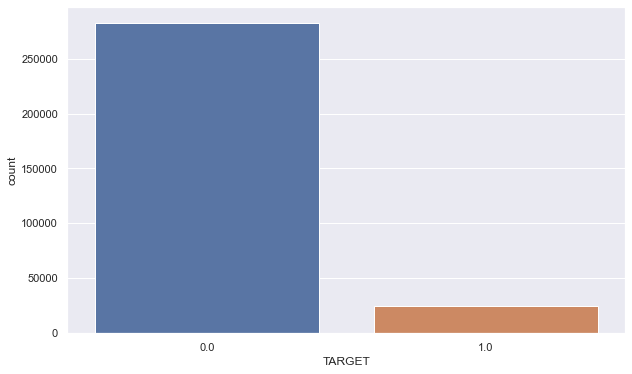

In [22]:
ax = sns.countplot(x='TARGET', data=train_df)
print(train_df['TARGET'].value_counts(normalize=True))

In [23]:
clf_lgbm.fit(X_train_std, Y_train)

LGBMClassifier(colsample_bytree=0.9497036, learning_rate=0.02, max_depth=8,
               min_child_weight=39.3259775, min_split_gain=0.0222415,
               n_estimators=10000, num_leaves=34, reg_alpha=0.041545473,
               reg_lambda=0.0735294, subsample=0.8715623, verbose=-1)

In [24]:
#Y_valid_pred = clf.predict(X_valid_std)

In [25]:
# print("Validation:")
# pd.crosstab(Y_valid_pred, Y_valid[target], rownames=['Predicted'], colnames=['Actual'])

In [26]:
# generate_model_report(Y_valid, Y_valid_pred)

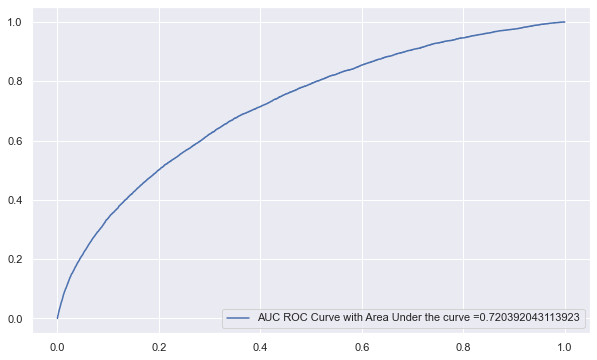

In [27]:
generate_auc_roc_curve(clf_lgbm, X_valid_std, Y_valid)

In [28]:
clf_lr.fit(X_train_std, Y_train)

LogisticRegression()

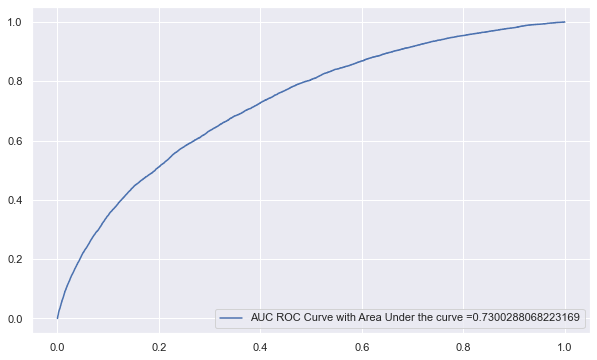

In [29]:
generate_auc_roc_curve(clf_lr, X_valid_std, Y_valid)

## Random undersampling

In [30]:
target = 'TARGET'
df = pd.DataFrame(X_train_std, columns=X_train.columns)
df[target] = Y_train
minority_class_len = len(df[df[target] == 1])
print(minority_class_len)

16655


In [31]:
majority_class_indices = df[df[target] == 0].index

In [32]:
random_majority_indices = np.random.choice(majority_class_indices,
                                           minority_class_len, 
                                           replace=False)
print(len(random_majority_indices))

16655


In [33]:
minority_class_indices = df[df[target] == 1].index

In [34]:
under_sample_indices = np.concatenate([minority_class_indices,random_majority_indices])

In [35]:
under_sample = df.loc[under_sample_indices]

In [36]:
under_sample[target].value_counts()

1.0    16655
0.0    16655
Name: TARGET, dtype: int64

In [37]:
X_train_std_us = under_sample.loc[:, df.columns!=target]
Y_train_us = under_sample.loc[:, df.columns==target]

In [39]:
clf_lgbm_us = clf_lgbm.fit(X_train_std_us, Y_train_us)
#Y_valid_us_pred = clf_us.predict(X_valid_std)

In [38]:
# print("Validation:")
# pd.crosstab(Y_valid_us_pred, Y_valid[target], rownames=['Predicted'], colnames=['Actual'])

In [40]:
# generate_model_report(Y_valid, Y_valid_us_pred)

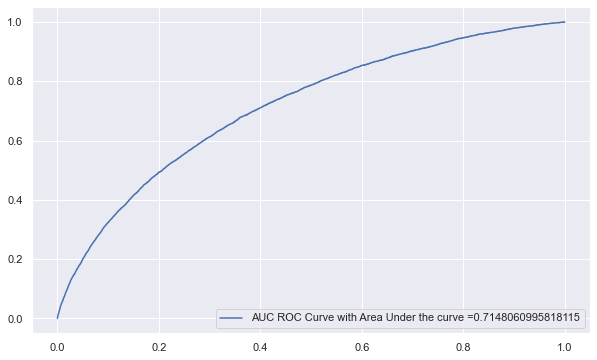

In [41]:
generate_auc_roc_curve(clf_lgbm_us, X_valid_std, Y_valid)

In [42]:
clf_lr_us = clf_lr.fit(X_train_std_us, Y_train_us)

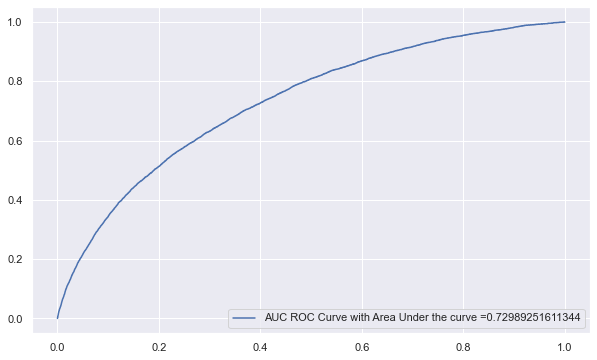

In [43]:
generate_auc_roc_curve(clf_lr_us, X_valid_std, Y_valid)

## Class_weight='balanced'

In [44]:
clf_lr_cw = LogisticRegression(class_weight='balanced').fit(X_train_std, Y_train)

In [45]:
clf_lgbm_cw = LGBMClassifier(
                        #nthread=4,
                        n_estimators=10000,
                        learning_rate=0.02,
                        num_leaves=34,
                        colsample_bytree=0.9497036,
                        subsample=0.8715623,
                        max_depth=8,
                        reg_alpha=0.041545473,
                        reg_lambda=0.0735294,
                        min_split_gain=0.0222415,
                        min_child_weight=39.3259775,
                        verbose=-1, 
                        class_weight='balanced').fit(X_train_std, Y_train)

In [58]:
from sklearn.utils import class_weight
class_weight.compute_class_weight(class_weight='balanced', classes=np.unique(Y_train), y=Y_train)

array([0.54397383, 6.18519964])

In [46]:
# Y_valid_pred = clf_cw.predict(X_valid_std)

In [47]:
# print("Validation:")
# pd.crosstab(Y_valid_pred, Y_valid[target], rownames=['Predicted'], colnames=['Actual'])

In [48]:
# generate_model_report(Y_valid, Y_valid_pred)

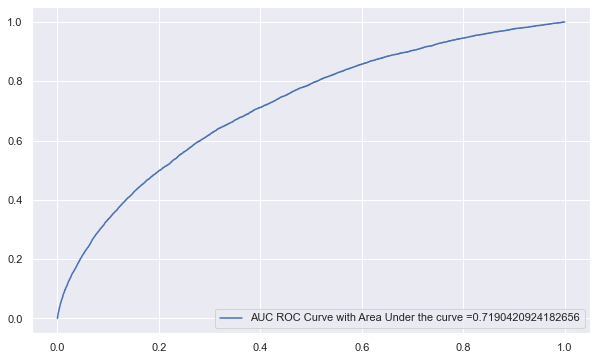

In [49]:
generate_auc_roc_curve(clf_lgbm_cw, X_valid_std, Y_valid)

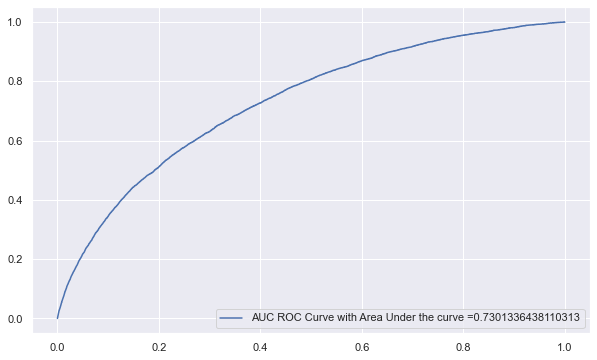

In [50]:
generate_auc_roc_curve(clf_lr_cw, X_valid_std, Y_valid)

In [60]:
# Define fbeta scorer with beta=3.16
scorer = make_scorer(fbeta_score, beta=3.16)

weights = np.linspace(0.05, 0.95, 10)
gsc = GridSearchCV(
    estimator=clf_lr,
    param_grid={
        'class_weight': [{0: x, 1: 1.0-x} for x in weights]
    },
    scoring=scorer,
    cv=3
)

grid_result = gsc.fit(X_train_std, Y_train)
print("Best parameters : %s" % grid_result.best_params_)

Best parameters : {'class_weight': {0: 0.05, 1: 0.95}}


<AxesSubplot:xlabel='weight'>

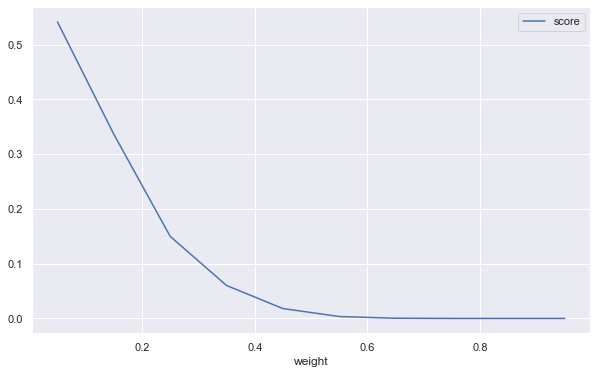

In [61]:
data_out = pd.DataFrame({'score': grid_result.cv_results_['mean_test_score'],
                       'weight': weights })
data_out.plot(x='weight')

In [62]:
clf_lr_cw_gs = LogisticRegression(**grid_result.best_params_).fit(X_train_std, Y_train)

In [64]:
# Y_valid_pred = clf_lr_cw_gs.predict(X_valid_std)

In [65]:
# print("Validation:")
# pd.crosstab(Y_valid_pred, Y_valid[target], rownames=['Predicted'], colnames=['Actual'])

In [66]:
# generate_model_report(Y_valid, Y_valid_pred)

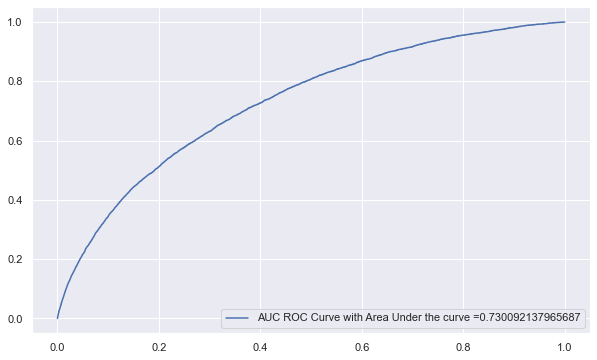

In [67]:
generate_auc_roc_curve(clf_lr_cw_gs, X_valid_std, Y_valid)

## SMOTE: Oversampling

In [68]:
unique, count = np.unique(Y_train, return_counts=True)
Y_train_dict_value_count = { k:v for (k,v) in zip(unique, count)}
Y_train_dict_value_count

{0.0: 189374, 1.0: 16655}

In [69]:
sm = SMOTE(random_state=12)
x_train_res, y_train_res = sm.fit_resample(X_train_std, Y_train)

In [70]:
pd.Series(y_train_res).value_counts()

0.0    189374
1.0    189374
dtype: int64

In [71]:
clf_lgbm_smote = clf_lgbm.fit(x_train_res, y_train_res)

In [72]:
# Y_valid_pred = clf_smote.predict(X_valid_std)

In [73]:
# print("Validation:")
# pd.crosstab(Y_valid_pred, Y_valid[target], rownames=['Predicted'], colnames=['Actual'])

In [74]:
# generate_model_report(Y_valid, Y_valid_pred)

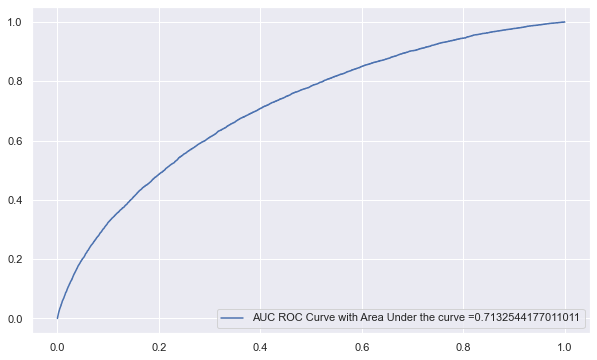

In [75]:
generate_auc_roc_curve(clf_lgbm_smote, X_valid_std, Y_valid)

In [76]:
clf_lr_smote = clf_lr.fit(x_train_res, y_train_res)

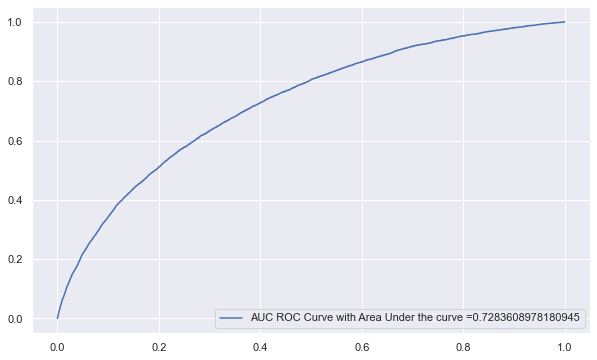

In [77]:
generate_auc_roc_curve(clf_lr_smote, X_valid_std, Y_valid)

In [78]:
# from sklearn.tree import DecisionTreeClassifier
# clf = DecisionTreeClassifier(random_state = 2)
# clf.fit(X_train,y_train)
# # y_pred = clf.predict(X_test)  # default threshold is 0.5
# y_pred = (clf.predict_proba(X_test)[:,1] >= 0.3).astype(bool) # set threshold as 0.3

# Modélisation

Les modèles de classification à optimiser :

* **Random Forest** :  
    * (n_estimators) Le nombre d'arbres
    * (max_depth) La profondeur maximale de l'arbre
    * (criterions) La fonction pour mesurer la qualité d'un split. « gini » pour l'impureté de Gini et « entropie » pour le gain d'informations.
* **Lightgbm** :
    * (max_depth) : contrôle la distance maximale entre le nœud racine de chaque arbre et un nœud feuille. Diminuer max_depth réduit le temps d'entraînement.
    * (num_leaves): définit le nombre maximal de nœuds par arbre. Diminuer num_leaves réduit le temps de entraînement.

In [9]:
mlflow.set_tracking_uri("sqlite:///mlflow.db")

In [10]:
mlflow.set_experiment("scoring")

2023/05/04 09:33:56 INFO mlflow.store.db.utils: Creating initial MLflow database tables...
2023/05/04 09:33:57 INFO mlflow.store.db.utils: Updating database tables
INFO  [alembic.runtime.migration] Context impl SQLiteImpl.
INFO  [alembic.runtime.migration] Will assume non-transactional DDL.
INFO  [alembic.runtime.migration] Running upgrade  -> 451aebb31d03, add metric step
INFO  [alembic.runtime.migration] Running upgrade 451aebb31d03 -> 90e64c465722, migrate user column to tags
INFO  [alembic.runtime.migration] Running upgrade 90e64c465722 -> 181f10493468, allow nulls for metric values
INFO  [alembic.runtime.migration] Running upgrade 181f10493468 -> df50e92ffc5e, Add Experiment Tags Table
INFO  [alembic.runtime.migration] Running upgrade df50e92ffc5e -> 7ac759974ad8, Update run tags with larger limit
INFO  [alembic.runtime.migration] Running upgrade 7ac759974ad8 -> 89d4b8295536, create latest metrics table
INFO  [89d4b8295536_create_latest_metrics_table_py] Migration complete!
INFO  

<Experiment: artifact_location='file:///D:/Documents/0Openclasseroom/P7_DS_03_04_2023/Implementez_un_modele_de_scoring/mlruns/1', creation_time=1683185643234, experiment_id='1', last_update_time=1683185643234, lifecycle_stage='active', name='scoring', tags={}>

## Baseline: DummyClassifier

In [90]:
mlflow.sklearn.autolog(disable=True)

with mlflow.start_run(run_name='Dummy_baseline'):
    params = {
        "strategy": 'most_frequent',
    }
    
    mlflow.set_tag("model_name", "Dummy")
    mlflow.log_params(params)
    
    dc = DummyClassifier(strategy='most_frequent', 
                         random_state=14)

    dc.fit(X_train_std, Y_train)
    
    y_pred_proba = dc.predict_proba(X_valid_std)[:, 1]
    dc_auc = roc_auc_score(Y_valid, y_pred_proba)
    print(dc_auc)
    
    mlflow.log_metric('Valid_auc', dc_auc)
    mlflow.sklearn.log_model(dc, "sk_models")  

0.5


## RandomForestClassifier

In [85]:
import logging

In [86]:
mlflow.sklearn.autolog(disable=True)

with mlflow.start_run(run_name='rf_baseline'):
    params = {
        "n_estimators": 100,
        "max_depth": 2
    }
    
    mlflow.set_tag("model_name", "RF")
    mlflow.log_params(params)
    
    rf = RandomForestClassifier(n_estimators=100, max_depth=2, class_weight='balanced')
    rf.fit(X_train_std, Y_train)
    
    y_pred_proba = rf.predict_proba(X_valid_std)[:, 1]
    rf_auc = roc_auc_score(Y_valid, y_pred_proba)
    print(rf_auc)
    
    mlflow.log_metric('Valid_auc', rf_auc)
    mlflow.sklearn.log_model(rf, "sk_models")     

0.7031540513698096


## Recherche des hyperparamètres 

In [110]:
def custom_score_(y_true, y_pred):
    # coût d'un faux positif et un faux négatif
    cout_fp = 1
    cout_fn = 10
    
    # nombre total d'exemples positifs et négatifs
    n_pos = (y_true==1).sum()
    n_neg = (y_true==0).sum()
    # calcul du coût maximum possible
    max_cout = cout_fp * n_neg + cout_fn * n_pos
    
    # Calcul du nombre de faux positifs et faux négatifs
    fp = ((y_pred == 1) & (y_true == 0)).sum()
    fn = ((y_pred == 0) & (y_true == 1)).sum()
    
    # calcul du coût total    
    cout = (cout_fp * fp + cout_fn * fn)  # / (fn + fp)
    cout_notmalise = cout/max_cout
    score = round(1 - cout_notmalise, 2)
    return score

custom_score = make_scorer(custom_score_, greater_is_better=True)

In [238]:
# Dictionnaire de regresseurs
classifier_grid = { 
               'Dummy': DummyClassifier(),     
               'LogisticReg': LogisticRegression(),
               'LGBM' : LGBMClassifier(),
               'Random Forest': RandomForestClassifier(),
               'Extra Tree' : ExtraTreesClassifier(),
            }
grid_params = { 'Dummy'        : {'strategy':['most_frequent']},
                'LogisticReg'  : {'class_weight':['balanced'],
                                 'solver':['newton-cg', 'lbfgs', 'liblinear', 'sag']},
                'Random Forest': {'class_weight':['balanced'],
                                  'max_depth': [3, 5, 7, 9],  #  The maximum depth of the tree.
                                  'n_estimators': [10, 200 , 500],  # ,  The number of trees in the forest. 
                                  'max_features': ['auto', 'sqrt', 'log2'],
                                  'criterion' :['gini', 'entropy']},
                'Extra Tree'   : {'class_weight':['balanced'],
                                  'n_estimators': [10, 200, 500],  # 
                                  'max_depth': [3, 5, 7, 9],  # 
                                  'max_features': ['auto', 'sqrt', 'log2'],
                                  'criterion' :['gini', 'entropy']},# 
                'LGBM'         : {'class_weight':['balanced'],
                                  'n_estimators': [150, 200, 500],  #  
                                  'learning_rate': [0.02, 0.08],  # 
                                  'max_depth': [5, 8, 9]}, #                                    
              } 

Dummy {'strategy': 'most_frequent'}
Dummy: AUROC = 0.5
Dummy: Score_metier = 0.53
Dummy: Accuracy = 0.92
Dummy: Recall = 0.0
Dummy: Presicion = 0.0
Dummy: run_time sec = 11.28
------------------
LogisticReg {'solver': 'liblinear', 'class_weight': 'balanced'}
LogisticReg: AUROC = 0.73
LogisticReg: Score_metier = 0.67
LogisticReg: Accuracy = 0.68
LogisticReg: Recall = 0.65
LogisticReg: Presicion = 0.15
LogisticReg: run_time sec = 120.75
------------------
LGBM {'n_estimators': 500, 'max_depth': 8, 'learning_rate': 0.02, 'class_weight': 'balanced'}
LGBM: AUROC = 0.74
LGBM: Score_metier = 0.68
LGBM: Accuracy = 0.7
LGBM: Recall = 0.65
LGBM: Presicion = 0.16
LGBM: run_time sec = 447.29
------------------
Random Forest {'n_estimators': 200, 'max_features': 'log2', 'max_depth': 9, 'criterion': 'entropy', 'class_weight': 'balanced'}
Random Forest: AUROC = 0.73
Random Forest: Score_metier = 0.67
Random Forest: Accuracy = 0.72
Random Forest: Recall = 0.61
Random Forest: Presicion = 0.16
Random Fo

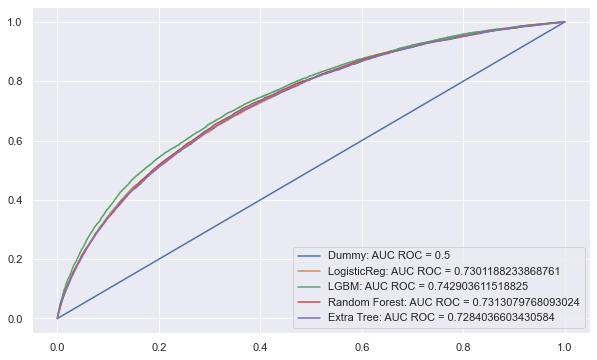

,AUROC,Score_metier,Accuracy,Recall,Presicion,run_time sec,best_params
Dummy,0.50,0.53,0.92,0.00,0.00,11.28,{'strategy': 'most_frequent'}
LogisticReg,0.73,0.67,0.68,0.65,0.15,120.75,"{'solver': 'liblinear', 'class_weight': 'balan..."
LGBM,0.74,0.68,0.70,0.65,0.16,447.29,"{'n_estimators': 500, 'max_depth': 8, 'learnin..."
Random Forest,0.73,0.67,0.72,0.61,0.16,5244.94,"{'n_estimators': 200, 'max_features': 'log2', ..."
Extra Tree,0.73,0.67,0.68,0.65,0.15,3879.67,"{'n_estimators': 500, 'max_features': 'sqrt', ..."


In [239]:
import warnings
warnings.filterwarnings("ignore")

# Les regressors sont testés 1 à 1 
df_Result = pd.DataFrame({})
mlflow.sklearn.autolog(disable=True)

fpr = dict()
tpr = dict()
thresholds = dict()

for name_clf, clf in classifier_grid.items() : 
    
    with mlflow.start_run(run_name=name_clf):
        model =  RandomizedSearchCV(clf,
                              grid_params[name_clf],
                              scoring = 'roc_auc',  # custom_score,
                              cv=10) 
        start_time = timeit.default_timer()
        model.fit(X_train_std, Y_train)

        y_pred_proba = model.predict_proba(X_valid_std)[:, 1]
        model_auc = roc_auc_score(Y_valid, y_pred_proba)
        y_pred = model.predict(X_valid_std)
        
        fpr[name_clf], tpr[name_clf], thresholds[name_clf] = roc_curve(Y_valid,  y_pred_proba)
        plt.plot(fpr[name_clf], tpr[name_clf], label= name_clf + ": AUC ROC = "+str(model_auc))
        plt.legend(loc=4)
        # calcul de l'erreur

        print(name_clf, str(model.best_params_) )
        
        metrics = {'AUROC': round(model_auc, 2),
                   'Score_metier': custom_score_(np.array(Y_valid.TARGET), y_pred.ravel()),
                   #'f_beta': round(fbeta_score(y_actual, y_predicted, beta=3.16), 2),
                   'Accuracy': round(accuracy_score(Y_valid, y_pred), 2),
                   'Recall': round(recall_score(Y_valid, y_pred), 2),
                   'Presicion': round(precision_score(Y_valid, y_pred), 2),
                   'run_time sec': round(timeit.default_timer() - start_time,2)}
        
        for key, val in metrics.items():
            df_Result.loc[name_clf, key] = val
            print(name_clf + ': ' + key + ' = ' + str(val))
        print("------------------")
        df_Result.loc[name_clf, 'best_params'] = str(model.best_params_)
        
        mlflow.set_tag("model_name", name_clf)
        mlflow.log_params(model.best_params_)
        mlflow.log_metrics(metrics)
        mlflow.sklearn.log_model(model, "sk_models") 

plt.show()
df_Result

In [252]:
# df_Result.to_csv('data/traited/df_models_results.csv', index = True)

## Comparaison des modèles

In [265]:
def Custom_score(y_true, y_pred):
    # coût d'un faux positif et un faux négatif
    cout_fp = 1
    cout_fn = 10
    
    # nombre total d'exemples positifs et négatifs
    n_pos = (y_true==1).sum()
    n_neg = (y_true==0).sum()
    # calcul du coût maximum possible
    max_cout = cout_fp * n_neg + cout_fn * n_pos
    
    # Calcul du nombre de faux positifs et faux négatifs
    fp = ((y_pred == 1) & (y_true == 0)).sum()
    fn = ((y_pred == 0) & (y_true == 1)).sum()
    
    # calcul du coût total    
    cout = (cout_fp * fp + cout_fn * fn)  # / (fn + fp)
    cout_notmalise = cout/max_cout
    score = round(1 - cout_notmalise, 2)
    return score

custom_score = make_scorer(Custom_score, greater_is_better=True)

In [266]:
def model_eval_score(model, Xval, yval):
    
    yval_pred = model.predict(Xval)
    
    metrics = {'AUROC_score': round(roc_auc_score(yval, model.predict_proba(Xval)[:, 1]), 2),
               'Costum_score': round(Custom_score(yval, yval_pred), 2),
               'f_beta_score': round(fbeta_score(yval, yval_pred, beta=3.16), 2),
               'Accuracy_score': round(accuracy_score(yval, yval_pred), 2),
               'Recall_score': round(recall_score(yval, yval_pred), 2),
               'Presicion_score': round(precision_score(yval, yval_pred), 2)}

    for key, val in metrics.items():
        print(key + ' : ' + str(val))
    print('conf_mat : \n' + str(confusion_matrix(yval, yval_pred)))
    print() 
    
    return metrics

In [269]:
warnings.filterwarnings("ignore")
classifier_grid = { 
               'Dummy': DummyClassifier(strategy='most_frequent'),     
               'LogisticReg': LogisticRegression(solver='liblinear', class_weight='balanced'),
               'LGBM' : LGBMClassifier(n_estimators=500,
                                       max_depth=8,
                                       learning_rate=0.02,
                                       class_weight='balanced'),
               'Random Forest': RandomForestClassifier(n_estimators=200,
                                                       max_features='log2',
                                                       max_depth=9,
                                                       criterion='entropy',
                                                       class_weight='balanced'),
               'Extra Tree' : ExtraTreesClassifier(n_estimators=500,
                                                   max_features='sqrt',
                                                   max_depth=7,
                                                   criterion='gini',
                                                   class_weight='balanced')}
df_results = pd.DataFrame({})
for name_clf, model in classifier_grid.items() :
    print('----- ' + name_clf + ' -------')
    start_time = timeit.default_timer()
    model.fit(X_train_std, Y_train)
   
    metrics = model_eval_score(model, X_valid_std, y_valid)

    for key, val in metrics.items():
        df_results.loc[name_clf, key] = val
        
    df_results.loc[name_clf, 'run_time'] = round(timeit.default_timer() - start_time,2)  
    print('rum_time :' + str(round(timeit.default_timer() - start_time,2)))
    print('----------------------')
df_results

----- Dummy -------
AUROC_score : 0.5
Costum_score : 0.53
f_beta_score : 0.0
Accuracy_score : 0.92
Recall_score : 0.0
Presicion_score : 0.0
conf_mat : 
[[93308     0]
 [ 8170     0]]

rum_time :0.23
----------------------
----- LogisticReg -------
AUROC_score : 0.73
Costum_score : 0.67
f_beta_score : 0.5
Accuracy_score : 0.68
Recall_score : 0.65
Presicion_score : 0.15
conf_mat : 
[[63851 29457]
 [ 2853  5317]]

rum_time :1.93
----------------------
----- LGBM -------
AUROC_score : 0.74
Costum_score : 0.68
f_beta_score : 0.51
Accuracy_score : 0.7
Recall_score : 0.65
Presicion_score : 0.16
conf_mat : 
[[65414 27894]
 [ 2820  5350]]

rum_time :8.59
----------------------
----- Random Forest -------
AUROC_score : 0.73
Costum_score : 0.67
f_beta_score : 0.49
Accuracy_score : 0.72
Recall_score : 0.61
Presicion_score : 0.16
conf_mat : 
[[68069 25239]
 [ 3218  4952]]

rum_time :96.01
----------------------
----- Extra Tree -------
AUROC_score : 0.73
Costum_score : 0.67
f_beta_score : 0.5
Accur

,AUROC_score,Costum_score,f_beta_score,Accuracy_score,Recall_score,Presicion_score,run_time
Dummy,0.50,0.53,0.00,0.92,0.00,0.00,0.23
LogisticReg,0.73,0.67,0.50,0.68,0.65,0.15,1.93
LGBM,0.74,0.68,0.51,0.70,0.65,0.16,8.59
Random Forest,0.73,0.67,0.49,0.72,0.61,0.16,96.01
Extra Tree,0.73,0.67,0.50,0.68,0.65,0.15,56.91


In [270]:
#df_results.to_csv('data/traited/df_models_results_comp.csv', index = True)

In [271]:
df_results.T

,Dummy,LogisticReg,LGBM,Random Forest,Extra Tree
AUROC_score,0.50,0.73,0.74,0.73,0.73
Costum_score,0.53,0.67,0.68,0.67,0.67
f_beta_score,0.00,0.50,0.51,0.49,0.50
Accuracy_score,0.92,0.68,0.70,0.72,0.68
Recall_score,0.00,0.65,0.65,0.61,0.65
Presicion_score,0.00,0.15,0.16,0.16,0.15
run_time,0.23,1.93,8.59,96.01,56.91


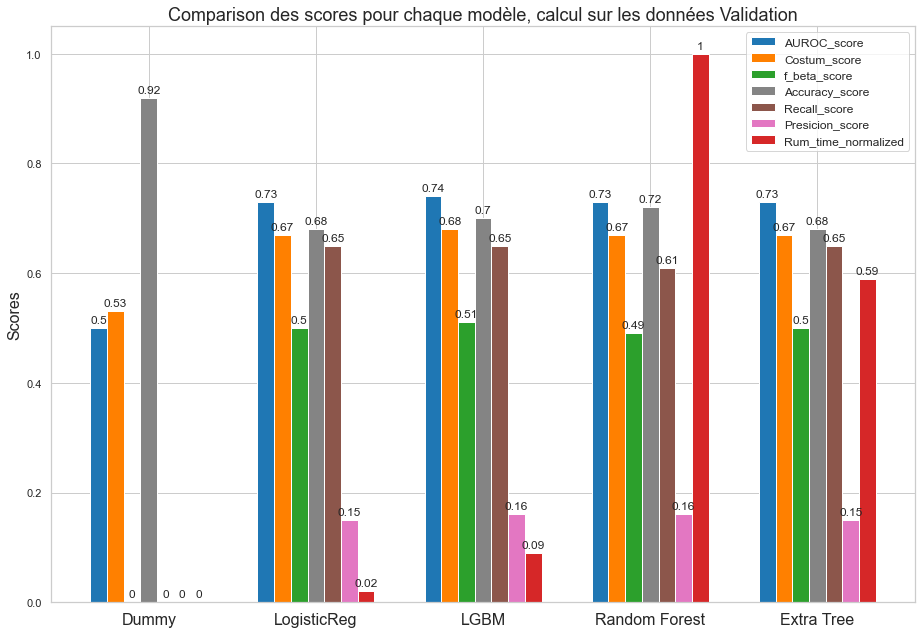

In [290]:
sns.set(style="whitegrid")
#from matplotlib import cm
#viridis=cm.get_cmap('viridis', 7) # viridis.colors[0]
from matplotlib.colors import ListedColormap
# Define custom colors
custom_colors = ['#1f77b4', '#FF8000', '#2ca02c', '#848484', '#8c564b', '#e377c2', '#d62728']
# Create custom colormap
custom_cmap = ListedColormap(custom_colors)

df = df_results.T
X = np.arange(len(df.columns))
fig = plt.figure(figsize=(12, 8))
ax = fig.add_axes([0,0,1,1])
AUROC = ax.bar(X - 3/10, df.iloc[0, :], color = custom_cmap(0), width = 1/10, label='AUROC_score')
Score_metier = ax.bar(X - 2/10, df.iloc[1, :], color = custom_cmap(1), width = 1/10, label='Costum_score')
f_beta = ax.bar(X - 1/10, df.iloc[2, :], color = custom_cmap(2), width = 1/10, label='f_beta_score')
Accuracy = ax.bar(X , df.iloc[3, :], color = custom_cmap(3), width = 1/10, label='Accuracy_score')
Recall = ax.bar(X + 1/10, df.iloc[4, :], color = custom_cmap(4), width = 1/10, label='Recall_score')
Presicion = ax.bar(X + 2/10, df.iloc[5, :], color = custom_cmap(5), width = 1/10, label='Presicion_score')
Time = ax.bar(X + 3/10, round(df.iloc[6, :]/max(df.iloc[6, :]), 2), color = custom_cmap(6), width = 1/10, label='Rum_time_normalized')

lines, labels = ax.get_legend_handles_labels()
ax.legend(lines , labels, loc=0, fontsize=12)

ax.set_ylabel('Scores',fontdict={'fontsize': 16})
ax.set_title('Comparison des scores pour chaque modèle, calcul sur les données Validation',fontdict={'fontsize': 18})
ax.set_xticks(X)
ax.set_xticklabels(df.columns,fontdict={'fontsize': 16})
ax.bar_label(AUROC, padding=3)
ax.bar_label(Score_metier, padding=3)
ax.bar_label(f_beta, padding=3)
ax.bar_label(Accuracy, padding=3)
ax.bar_label(Recall, padding=3)
ax.bar_label(Presicion, padding=3)
ax.bar_label(Time, padding=3)
fig.tight_layout()
plt.show()

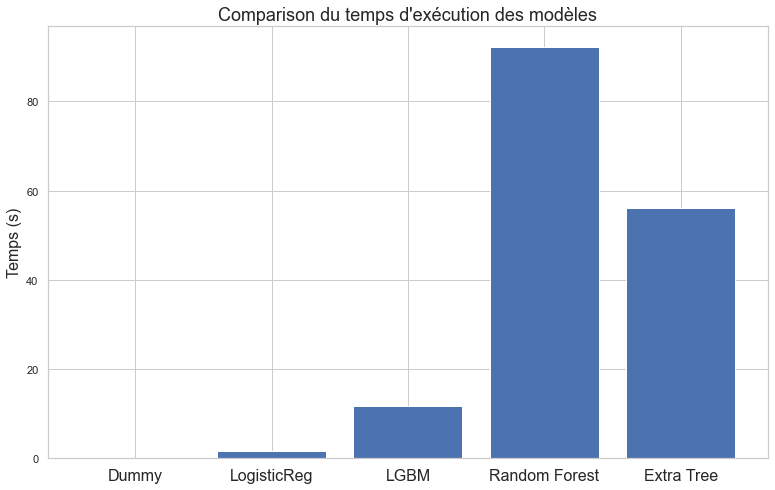

In [301]:
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(df.columns, df.loc['run_time sec', :])
ax.set_title("Comparison du temps d'exécution des modèles",fontdict={'fontsize': 18})
ax.set_ylabel('Temps (s)',fontdict={'fontsize': 16})
ax.set_xticklabels(df.columns,fontdict={'fontsize': 16})
plt.show()

## Etude du seuil

### LogisticRegression

In [243]:
model_lr = LogisticRegression(solver='liblinear', class_weight='balanced')
start_time = timeit.default_timer()
model_lr.fit(X_train_std, Y_train)
print("Time: ", round(timeit.default_timer() - start_time,2))

Time:  1.89


In [244]:
print("Valid  Accuracy : %.2f"%model_lr.score(X_valid_std, Y_valid))
print("Train Accuracy : %.2f"%model_lr.score(X_train_std, Y_train))
print()
print("Confusion Matrix: ")
print(confusion_matrix(Y_valid, model_lr.predict(X_valid_std)))
print()
print("Classification Report:")
print(classification_report(Y_valid, model_lr.predict(X_valid_std)))
#print("f_beta: ", fbeta_score(np.array(Y_valid.TARGET), model_lr.predict(X_valid_std), beta=3.16) 
print("Score Métier: ", custom_score_(np.array(Y_valid.TARGET), model_lr.predict(X_valid_std)))
print("AUROC: ", roc_auc_score(Y_valid, model_lr.predict_proba(X_valid_std)[:, 1]))

Valid  Accuracy : 0.68
Train Accuracy : 0.68

Confusion Matrix: 
[[63851 29457]
 [ 2853  5317]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.96      0.68      0.80     93308
         1.0       0.15      0.65      0.25      8170

    accuracy                           0.68    101478
   macro avg       0.56      0.67      0.52    101478
weighted avg       0.89      0.68      0.75    101478

Score Métier:  0.67
AUROC:  0.7301188233868761


In [245]:
y_pred_proba = model_lr.predict_proba(X_valid_std)[:, 1]
fpr, tpr, thresholds = roc_curve(Y_valid,  y_pred_proba)

In [246]:
# print("threshold:", "\ttpr: ", "\t\tfpr:", "\t\tScore_metier:")
# for thresholds_, tpr_, fpr_ in zip(thresholds, tpr, fpr):
#     y_pred_thr = np.multiply(y_pred_proba >= thresholds_, 1)
#     score_thr = custom_score_(np.array(Y_valid.TARGET), y_pred_thr)
#     print("%.3f" %thresholds_, "\t\t%.3f" %tpr_, "\t\t%.3f" %fpr_, "\t\t%.2f" %score_thr)

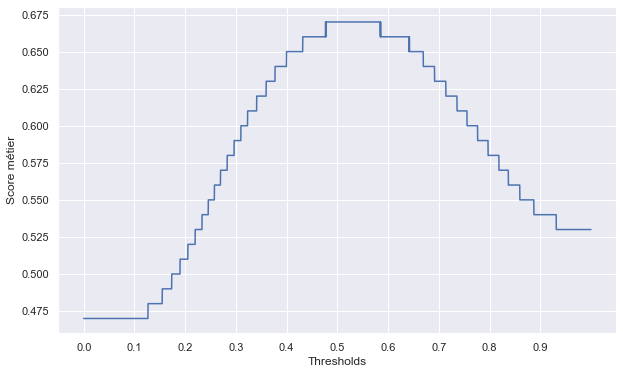

In [247]:
score_thr = []
thresholds_list = np.linspace(0, 1, 10000)
for thresholds_ in thresholds_list:
    y_pred_thr = np.multiply(y_pred_proba >= thresholds_, 1)
    score_thr.append(custom_score_(np.array(Y_valid.TARGET), y_pred_thr))

plt.plot(thresholds_list, score_thr)
plt.xlabel('Thresholds')
plt.xticks(np.arange(0, 1, 0.1))
plt.ylabel('Score métier')
plt.show()

Le seuil **0.5** permet de maximiser le score métier. Ce seuil qui est déjà le seuil par défaut dans la méthode prédict sera choisi pour la suite.

### LGBM

In [248]:
model_lgbm = LGBMClassifier(n_estimators=500, max_depth=8, learning_rate=0.02, class_weight='balanced')
start_time = timeit.default_timer()
model_lgbm.fit(X_train_std, Y_train)
print("Time: ", round(timeit.default_timer() - start_time,2))
y_pred_proba = model_lgbm.predict_proba(X_valid_std)[:, 1]
fpr, tpr, thresholds = roc_curve(Y_valid,  y_pred_proba)

Time:  9.0


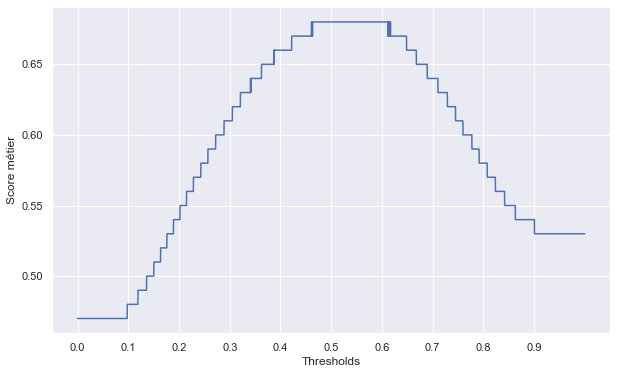

In [249]:
score_thr = []
thresholds_list = np.linspace(0, 1, 10000)
for thresholds_ in thresholds_list:
    y_pred_thr = np.multiply(y_pred_proba >= thresholds_, 1)
    score_thr.append(custom_score_(np.array(Y_valid.TARGET), y_pred_thr))

plt.plot(thresholds_list, score_thr)
plt.xlabel('Thresholds')
plt.xticks(np.arange(0, 1, 0.1))
plt.ylabel('Score métier')
plt.show()

In [250]:
print("Valid  Accuracy : %.2f"%model_lgbm.score(X_valid_std, Y_valid))
print("Train Accuracy : %.2f"%model_lgbm.score(X_train_std, Y_train))
print()
print("Confusion Matrix: ")
print(confusion_matrix(Y_valid, model_lgbm.predict(X_valid_std)))
print()
print("Classification Report:")
print(classification_report(Y_valid, model_lgbm.predict(X_valid_std)))
#print("f_beta: ", fbeta_score(np.array(Y_valid.TARGET), model_lr.predict(X_valid_std), beta=3.16) 
print("Score Métier: ", custom_score_(np.array(Y_valid.TARGET), model_lgbm.predict(X_valid_std)))
print("AUROC: ", roc_auc_score(Y_valid, model_lgbm.predict_proba(X_valid_std)[:, 1]))

Valid  Accuracy : 0.70
Train Accuracy : 0.71

Confusion Matrix: 
[[65414 27894]
 [ 2820  5350]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.96      0.70      0.81     93308
         1.0       0.16      0.65      0.26      8170

    accuracy                           0.70    101478
   macro avg       0.56      0.68      0.53    101478
weighted avg       0.89      0.70      0.77    101478

Score Métier:  0.68
AUROC:  0.742903611518825


Le seuil **0.5** permet de maximiser le score métier. Ce seuil qui est déjà le seuil par défaut dans la méthode prédict sera choisi pour la suite.

# Interprétabilité du modèle

In [11]:
target_names = ['Bon client', 'Client a risque']
feature_names = train_df.drop(columns=["SK_ID_CURR", 'TARGET']).columns

In [12]:
feature_names

Index(['EXT_SOURCE_2', 'PREV_DAYS_DECISION_MEAN',
       'BURO_MONTHS_BALANCE_SIZE_MEAN', 'DAYS_REGISTRATION',
       'PREV_NAME_YIELD_GROUP_low_normal_MEAN',
       'PREV_NAME_YIELD_GROUP_high_MEAN', 'REGION_POPULATION_RELATIVE',
       'PREV_NAME_PAYMENT_TYPE_Cashthroughthebank_MEAN',
       'BURO_DAYS_CREDIT_MAX', 'POS_MONTHS_BALANCE_MEAN',
       'BURO_CREDIT_TYPE_Creditcard_MEAN', 'CLOSED_DAYS_CREDIT_MAX',
       'BURO_STATUS_0_MEAN_MEAN', 'HOUR_APPR_PROCESS_START',
       'PREV_NAME_PRODUCT_TYPE_XNA_MEAN',
       'PREV_NAME_SELLER_INDUSTRY_Consumerelectronics_MEAN',
       'CC_AMT_CREDIT_LIMIT_ACTUAL_SUM', 'PREV_NAME_TYPE_SUITE_nan_MEAN',
       'CLOSED_DAYS_CREDIT_MEAN', 'ACTIVE_DAYS_CREDIT_MIN',
       'BURO_DAYS_CREDIT_MIN', 'EXT_SOURCE_3', 'EXT_SOURCE_1',
       'BURO_DAYS_CREDIT_MEAN', 'DAYS_BIRTH', 'BURO_CREDIT_ACTIVE_Active_MEAN',
       'ACTIVE_DAYS_CREDIT_MAX', 'PREV_NAME_CONTRACT_STATUS_Approved_MEAN',
       'DAYS_LAST_PHONE_CHANGE', 'REFUSED_DAYS_DECISION_MAX',
      

In [13]:
len(feature_names)

33

## Interprétation globale des modèles

In [61]:
train_df.head()

,EXT_SOURCE_2,PREV_DAYS_DECISION_MEAN,BURO_MONTHS_BALANCE_SIZE_MEAN,DAYS_REGISTRATION,PREV_NAME_YIELD_GROUP_low_normal_MEAN,PREV_NAME_YIELD_GROUP_high_MEAN,REGION_POPULATION_RELATIVE,PREV_NAME_PAYMENT_TYPE_Cashthroughthebank_MEAN,BURO_DAYS_CREDIT_MAX,POS_MONTHS_BALANCE_MEAN,...,BURO_CREDIT_ACTIVE_Active_MEAN,ACTIVE_DAYS_CREDIT_MAX,PREV_NAME_CONTRACT_STATUS_Approved_MEAN,DAYS_LAST_PHONE_CHANGE,REFUSED_DAYS_DECISION_MAX,ACTIVE_DAYS_CREDIT_MEAN,PREV_DAYS_DECISION_MIN,DAYS_ID_PUBLISH,TARGET,SK_ID_CURR
0,0.262949,-606.000000,13.75,-3648.0,1.000000,0.000000,0.018801,0.000000,-103.0,-10.000000,...,0.250,-103.0,1.000000,-1134.0,-396.0,-572.500000,-606.0,-2120,1.0,100002
1,0.622246,-1305.000000,24.75,-1186.0,0.333333,0.000000,0.003541,0.666667,-606.0,-43.785714,...,0.250,-606.0,1.000000,-828.0,-396.0,-606.000000,-2341.0,-291,0.0,100003
2,0.555912,-815.000000,24.75,-4260.0,0.000000,0.000000,0.010032,1.000000,-408.0,-25.500000,...,0.000,-258.0,1.000000,-815.0,-396.0,-537.309524,-815.0,-2531,0.0,100004
3,0.650442,-272.444444,24.75,-9833.0,0.222222,0.222222,0.008019,0.444444,-300.0,-9.619048,...,0.375,-258.0,0.555556,-617.0,-181.0,-537.309524,-617.0,-2437,0.0,100006
4,0.322738,-1222.833333,24.75,-4311.0,0.000000,0.500000,0.028663,0.833333,-1149.0,-33.636364,...,0.000,-258.0,1.000000,-1106.0,-396.0,-537.309524,-2357.0,-3458,0.0,100007


### LogisticRegression

In [57]:
model_lr = LogisticRegression(solver='lbfgs', class_weight='balanced')
model_lr.fit(X_train_std, Y_train)

LogisticRegression(class_weight='balanced')

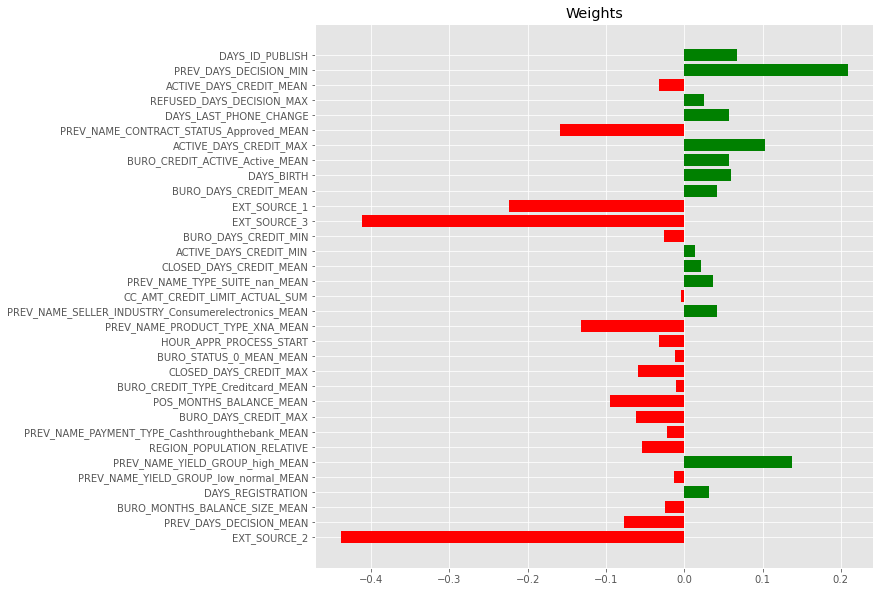

In [58]:
with plt.style.context("ggplot"):
    fig = plt.figure(figsize=(10,10))
    plt.barh(range(len(model_lr.coef_[0])), model_lr.coef_[0], color=["red" if coef<0 else "green" for coef in model_lr.coef_[0]])
    plt.yticks(range(len(model_lr.coef_[0])), feature_names);
    plt.title("Weights")

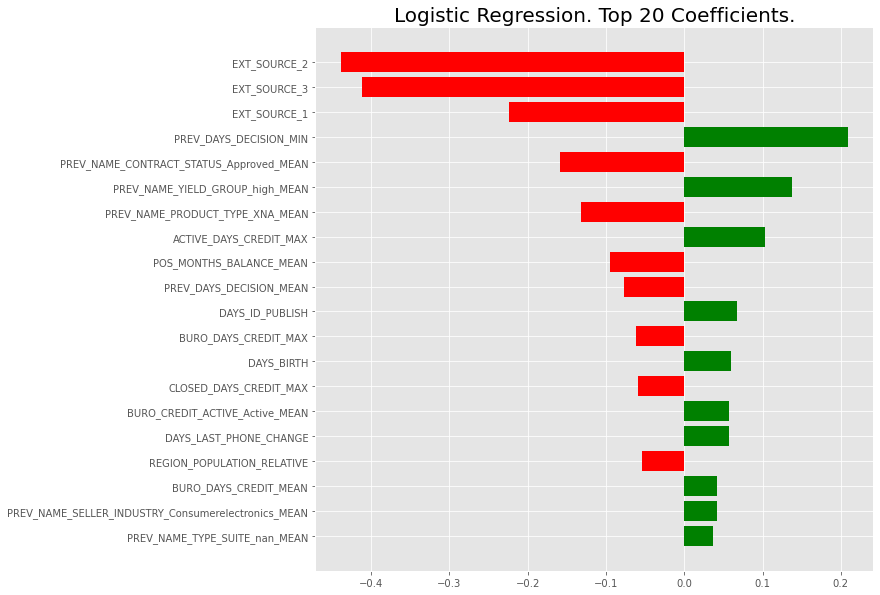

In [59]:
with plt.style.context("ggplot"):
    fig = plt.figure(figsize=(10,10))
    top_x = 20
    logistic_reg_coeff = model_lr.coef_[0]
    idx = np.argsort(np.abs(logistic_reg_coeff))[::-1] 
    plt.barh(feature_names[idx[:top_x]][::-1], logistic_reg_coeff[idx[:top_x]][::-1], color=["red" if coef<0 else "green" for coef in logistic_reg_coeff[idx[:top_x]][::-1]])
    plt.yticks(feature_names[idx[:top_x]][::-1]);
    plt.title("Logistic Regression. Top " + str(top_x) + " Coefficients.", fontsize=20, fontweight="normal")

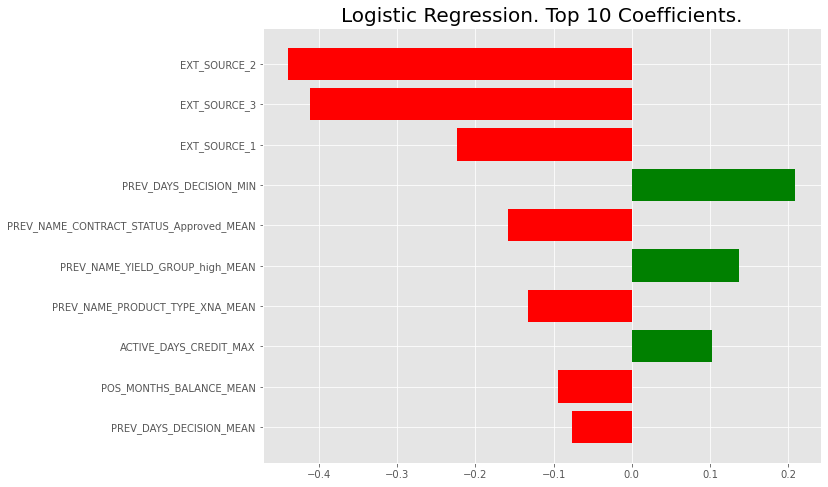

In [60]:
with plt.style.context("ggplot"):
    fig = plt.figure(figsize=(10,8))
    top_x = 10
    logistic_reg_coeff = model_lr.coef_[0]
    idx = np.argsort(np.abs(logistic_reg_coeff))[::-1] 
    plt.barh(feature_names[idx[:top_x]][::-1], logistic_reg_coeff[idx[:top_x]][::-1], color=["red" if coef<0 else "green" for coef in logistic_reg_coeff[idx[:top_x]][::-1]])
    plt.yticks(feature_names[idx[:top_x]][::-1]);
    plt.title("Logistic Regression. Top " + str(top_x) + " Coefficients.", fontsize=20, fontweight="normal")

Les 5 variables les plus importantes dans la classification selon le modèle Logistic Regression sont: 

Très corrélées à la classe 0 c-a-d 'Bon client':   
* **Ext_source_1**: Normalized score from external data source
* **Ext_source_2**: Normalized score from external data source
* **Ext_source_3**: Normalized score from external data source
* **PREV_NAME_CONTRACT_STATUS_Approved_MEAN**: (La moyenne de nombre de crédit accordée)  

Très corrélées à la classe 1 c-a-d 'Client à risque':  
* **PREV_DAYS_DECISION_MIN**: (Nombre de jours depuis le dernier crédit)   


Montant du crédit: 568800.0 (AMT_CREDIT)

Durée restante en jours du crédit précédent par rapport à la date de la demande en cours (maximum): 1778.0 (BURO_DAYS_CREDIT_ENDDATE_MAX)

Différence entre date de naissance du client et date de la demande en cours : -19241 (DAYS_BIRTH)

Différence entre date de début de l’emploi actuel du client et la date de la demande en cours: -2329.0 (DAYS_EMPLOYED)

Score normalisé à partir d'une source de données externe: 0.79 (EXT_SOURCE_2)

Score normalisé à partir d'une source de données externe: 0.16 (EXT_SOURCE_3)

Le client a-t-il un diplôme de l'enseignement supérieur ?: Oui - (NAME_EDUCATION_TYPE_Higher education)

Rapport entre annuité et montant du crédit: 0.04 (PAYMENT_RATE)

Durée des crédits précédents (en mois, par rapport à la date de la demande en cours) - moyenne: 8.0 (PREV_CNT_PAYMENT_MEAN)

Le taux d’intérêt du crédit précèdent était élevé?: Oui - (PREV_NAME_YIELD_GROUP_high_MEAN)

### Tree based models

In [ ]:
tree_models = [{"name": 'LGBM', "fi": LGBMClassifier(n_estimators=500,
                                 max_depth=8,
                                 learning_rate=0.02,
                                 class_weight='balanced').fit(X_train_std, Y_train).feature_importances_},
         {"name": 'Random Forest', "fi": RandomForestClassifier(n_estimators=200,
                                           max_features='log2',
                                           max_depth=9,
                                           criterion='entropy',
                                           class_weight='balanced').fit(X_train_std, Y_train).feature_importances_},
         {"name": 'Extra Tree', "fi":ExtraTreesClassifier(n_estimators=500,
                                       max_features='sqrt',
                                       max_depth=7,
                                       criterion='gini',
                                       class_weight='balanced').fit(X_train_std, Y_train).feature_importances_}]

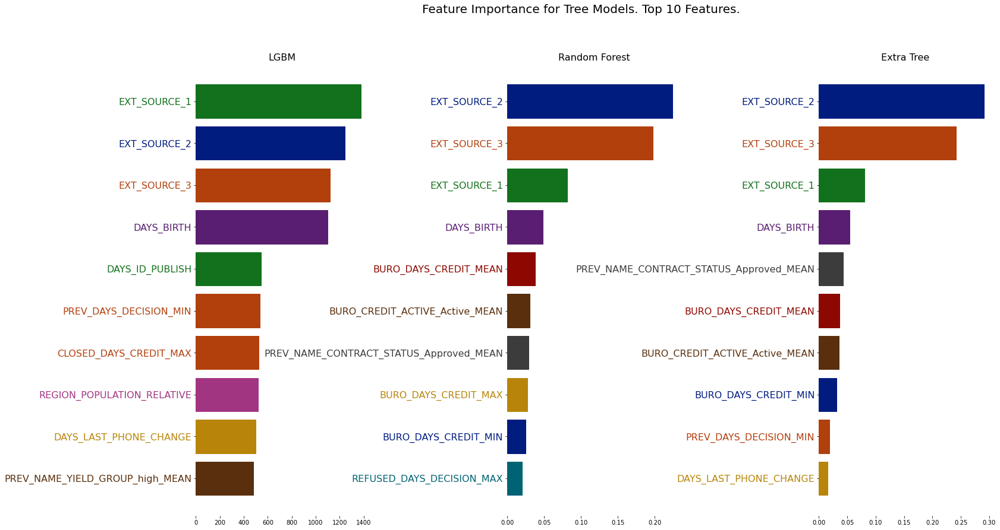

In [62]:
fig, axs = plt.subplots(1,3, figsize=(24, 14), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.5, wspace=0.8)
axs = axs.ravel()
top_x = 10 # number of x most important features to show
for i in range(len(tree_models)):
    feature_importance = tree_models[i]["fi"]
    indices = np.argsort(feature_importance)
    indices = indices[-top_x:]

    bars = axs[i].barh(range(len(indices)), feature_importance[indices], color='b', align='center') 
    axs[i].set_title(tree_models[i]["name"], fontweight="normal", fontsize=16)

    plt.sca(axs[i])
    plt.yticks(range(len(indices)), [feature_names[j] for j in indices], fontweight="normal", fontsize=16) 

    # print(len(plt.gca().get_yticklabels()), len(indices))
    for i, ticklabel in enumerate(plt.gca().get_yticklabels()):
        ticklabel.set_color(color_list[indices[i]])  

    for i,bar in enumerate(bars):
        bar.set_color(color_list[indices[i]])
        plt.box(False)
    plt.suptitle("Feature Importance for Tree Models. Top " + str(top_x) + " Features.", fontsize=20, fontweight="normal")

Ces valeurs d'importance des variables semblent intéressantes. Les 3 modèles se basent sur ces 4 principales variables:
* **Ext_source_1**: Normalized score from external data source
* **Ext_source_2**: Normalized score from external data source
* **Ext_source_3**: Normalized score from external data source
* **DAYS_BIRTH** : Client's age in days at the time of application  
ce qui suggère qu'il sagit de variables importantes pour la classification. 

Il y a plusieurs limitations ici. Les scores d'importance des variables sont relatifs, ce qui les rend difficiles à interpréter par rapport à la classification. Bien qu'ils nous disent que les score exterieurs sont relativement plus importants que l'age du client pour le modèle d'arbre de décision, ils ne nous disent pas dans quelle mesure une augmentation de 0.1 des scores affecte la probabilité qu'un client soit à risque.  

Les mesures d'importance des variables sont des estimations globales sur l'ensemble de données d'entraînement. Pour un sous-ensemble de clients, au sein du même modèle, l'ordre et l'ampleur de l'importance des variables peuvent changer. Ainsi, bien que nous sachions que les scores extérieurs sont importants en moyenne, nous ne pouvons pas répondre avec certitude à la question : comment les scores affectent-ils un client spécifique ? Ces limites rendent souhaitable l'exploration d'explications locales.

## Interprétation locale des modèles

### Lime values

Local Interpretable Model-agnostic Explanation (LIME) fournit une méthode rapide et relativement simple pour expliquer localement les modèles de boîte noire. L'algorithme LIME peut être simplifié en quelques étapes:
* Pour un point de données, perturbez de manière aléatoire ses variables à plusieurs reprises. Pour les données tabulaires, cela implique d'ajouter une petite quantité de bruit à chaque entité.
* Obtenez des prédictions pour chaque instance de données perturbée. Cela nous aide à construire une image locale de la surface de décision à ce point.
* Utilisez des prédictions pour calculer un "modèle d'explication" linéaire approximatif à l'aide de prédictions. Les coefficients du modèle linéaire sont utilisés comme explications.

La bibliothèque python LIME fournit des interfaces pour expliquer les modèles construits sur des données tabulaires (TabularExplainer), image (LimeImageExplainer) et textuelles (LimeTextExplainer).

In [68]:
trained_models = [{"name": 'LR', "model": LogisticRegression(solver='lbfgs', class_weight='balanced').fit(X_train_std, Y_train)},
         {"name": 'LGBM', "model": LGBMClassifier(n_estimators=500,
                                                  max_depth=8,
                                                  learning_rate=0.02,
                                                  class_weight='balanced').fit(X_train_std, Y_train)},
         {"name": 'Random Forest', "model": RandomForestClassifier(n_estimators=200,
                                           max_features='log2',
                                           max_depth=9,
                                           criterion='entropy',
                                           class_weight='balanced').fit(X_train_std, Y_train)},
         {"name": 'Extra Tree', "model":ExtraTreesClassifier(n_estimators=500,
                                       max_features='sqrt',
                                       max_depth=7,
                                       criterion='gini',
                                       class_weight='balanced').fit(X_train_std, Y_train)}]

In [182]:
explainer = lime_tabular.LimeTabularExplainer(X_train_std, mode="classification",
                                              class_names=['Bon client', 'Client a risque'],
                                              feature_names=feature_names,
                                             )

explainer

**Bon client prédit Bon:**

In [82]:
idx = random.randint(1, len(X_valid_std))
print("Actual :     ", target_names[int(np.array(Y_valid.TARGET)[idx])])
lime_metrics = []
for current_model in trained_models:
    print("Classifieur : ",  current_model["name"])
    print("Prediction : ", target_names[int(current_model["model"].predict(X_valid_std[idx].reshape(1,-1))[0])])
    explanation = explainer.explain_instance(X_valid_std[idx], current_model["model"].predict_proba, num_features=10)
    explanation.show_in_notebook()
    lime_metrics.append({"lime class1": explanation.local_pred[0],
                         "actual class1": current_model["model"].predict_proba(X_valid_std[idx].reshape(1,-1))[0][1],
                         "model": current_model["name"] })

Actual :      Bon client
Classifieur :  LR
Prediction :  Bon client


Classifieur :  LGBM
Prediction :  Bon client


C:\Users\rimla\AppData\Roaming\Python\Python39\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "


C:\Users\rimla\AppData\Roaming\Python\Python39\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "


Classifieur :  Random Forest
Prediction :  Bon client


Classifieur :  Extra Tree
Prediction :  Bon client


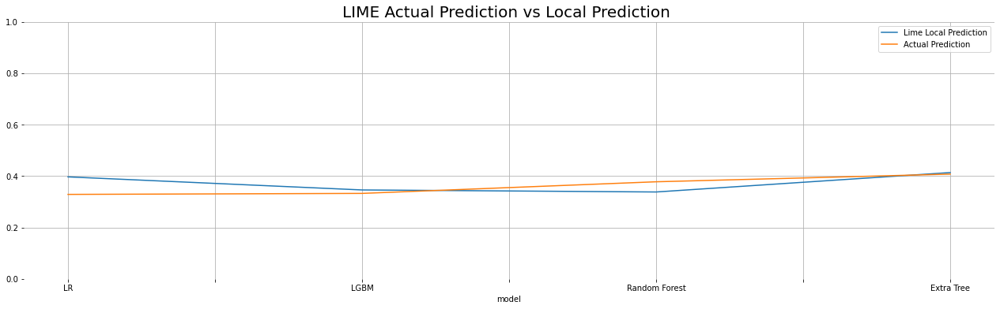

In [83]:
# Plot run time for explanations
lime_metrics_df = pd.DataFrame(lime_metrics)  
lime_metrics_df_ax = lime_metrics_df[["lime class1", "actual class1", "model"]].plot(kind="line", x="model", title="LIME Actual Prediction vs Local Prediction ", figsize=(22,6))
lime_metrics_df_ax.title.set_size(20)
lime_metrics_df_ax.legend(["Lime Local Prediction", "Actual Prediction"])
plt.ylim((0, 1))
plt.grid()
plt.box(False)

Le graphique ci-dessus montre les prédictions faites par le modèle local LIME et le modèle original pour l'instance de données expliquée. Les deux nombres doivent être prochespour pouvoir faire confiance à l'explication.

**Bon Client prédit à risque**

In [84]:
model_lr = LogisticRegression(solver='lbfgs', class_weight='balanced')
model_lr.fit(X_train_std, Y_train)
preds = model_lr.predict(X_valid_std)
false_preds = np.argwhere(preds != np.array(Y_valid.TARGET)).flatten()
idx  = random.choice(false_preds)

In [85]:
print("Actual :     ", target_names[int(np.array(Y_valid.TARGET)[idx])])
lime_metrics = []
for current_model in trained_models:
    print("Classifieur : ",  current_model["name"])
    print("Prediction : ", target_names[int(current_model["model"].predict(X_valid_std[idx].reshape(1,-1))[0])])
    explanation = explainer.explain_instance(X_valid_std[idx], current_model["model"].predict_proba, num_features=10)
    explanation.show_in_notebook()
    lime_metrics.append({"lime class1": explanation.local_pred[0],
                         "actual class1": current_model["model"].predict_proba(X_valid_std[idx].reshape(1,-1))[0][1],
                         "model": current_model["name"] })

Actual :      Bon client
Classifieur :  LR
Prediction :  Client a risque


Classifieur :  LGBM
Prediction :  Client a risque


C:\Users\rimla\AppData\Roaming\Python\Python39\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "


C:\Users\rimla\AppData\Roaming\Python\Python39\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "


Classifieur :  Random Forest
Prediction :  Client a risque


Classifieur :  Extra Tree
Prediction :  Client a risque


**Client à risque**

In [86]:
false_preds = np.argwhere(np.array(Y_valid.TARGET) == 1).flatten()
idx  = random.choice(false_preds)

In [87]:
print("Actual :     ", target_names[int(np.array(Y_valid.TARGET)[idx])])
lime_metrics = []
for current_model in trained_models:
    print("Classifieur : ",  current_model["name"])
    print("Prediction : ", target_names[int(current_model["model"].predict(X_valid_std[idx].reshape(1,-1))[0])])
    explanation = explainer.explain_instance(X_valid_std[idx], current_model["model"].predict_proba, num_features=10)
    explanation.show_in_notebook()
    lime_metrics.append({"lime class1": explanation.local_pred[0],
                         "actual class1": current_model["model"].predict_proba(X_valid_std[idx].reshape(1,-1))[0][1],
                         "model": current_model["name"] })

Actual :      Client a risque
Classifieur :  LR
Prediction :  Client a risque


Classifieur :  LGBM
Prediction :  Client a risque


C:\Users\rimla\AppData\Roaming\Python\Python39\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "


C:\Users\rimla\AppData\Roaming\Python\Python39\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "


Classifieur :  Random Forest
Prediction :  Client a risque


Classifieur :  Extra Tree
Prediction :  Client a risque


### Shap values

In [95]:
idx = random.randint(1, len(X_valid_std))
print(idx)
print("Actual :     ", target_names[int(np.array(Y_valid.TARGET)[idx])])

Actual :      Bon client


In [102]:
df_idx = pd.DataFrame(X_valid_std[idx].reshape(1,-1), columns=feature_names)
df_idx

,EXT_SOURCE_2,PREV_DAYS_DECISION_MEAN,BURO_MONTHS_BALANCE_SIZE_MEAN,DAYS_REGISTRATION,PREV_NAME_YIELD_GROUP_low_normal_MEAN,PREV_NAME_YIELD_GROUP_high_MEAN,REGION_POPULATION_RELATIVE,PREV_NAME_PAYMENT_TYPE_Cashthroughthebank_MEAN,BURO_DAYS_CREDIT_MAX,POS_MONTHS_BALANCE_MEAN,...,BURO_DAYS_CREDIT_MEAN,DAYS_BIRTH,BURO_CREDIT_ACTIVE_Active_MEAN,ACTIVE_DAYS_CREDIT_MAX,PREV_NAME_CONTRACT_STATUS_Approved_MEAN,DAYS_LAST_PHONE_CHANGE,REFUSED_DAYS_DECISION_MAX,ACTIVE_DAYS_CREDIT_MEAN,PREV_DAYS_DECISION_MIN,DAYS_ID_PUBLISH
0,-1.240522,0.218938,-0.088329,-1.598728,-0.348433,-0.314868,-0.083931,0.05971,-1.572639,0.154587,...,-1.720416,-1.25669,-1.426312,0.280232,0.188501,1.160183,0.239029,0.191647,0.040654,-1.195671


**LGBM Model**

In [107]:
current_model = trained_models[1] # Explain the lgbm Model
print("Classifieur : ",  current_model["name"])
print("Prediction : ", target_names[int(current_model["model"].predict(X_valid_std[idx].reshape(1,-1))[0])])
sub_sampled_train_data = shap.sample(X_train_std, 600, random_state=0) # use 600 samples of train data as background data

subsampled_test_data =X_valid_std[idx].reshape(1,-1)

start_time = time.time()
explainer = shap.KernelExplainer(current_model["model"].predict_proba, sub_sampled_train_data)
shap_values = explainer.shap_values(subsampled_test_data,  l1_reg="aic")
elapsed_time = time.time() - start_time
# explain first sample from test data
print("Kernel Explainer SHAP run time", round(elapsed_time,3) , " seconds. ", current_model["name"])
print("SHAP expected value", explainer.expected_value)
print("Model mean value", current_model["model"].predict_proba(X_train_std).mean(axis=0))
print("Model prediction for test data", current_model["model"].predict_proba(subsampled_test_data))
shap.initjs()
pred_ind = 0
shap.force_plot(explainer.expected_value[1], shap_values[1][0], subsampled_test_data[0], feature_names=feature_names)

Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
Using 600 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


Classifieur :  LGBM
Prediction :  Bon client


  0%|          | 0/1 [00:00<?, ?it/s]

Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.


Kernel Explainer SHAP run time 11.824  seconds.  LGBM
SHAP expected value [0.57910801 0.42089199]
Model mean value [0.58982127 0.41017873]
Model prediction for test data [[0.75809127 0.24190873]]


Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.


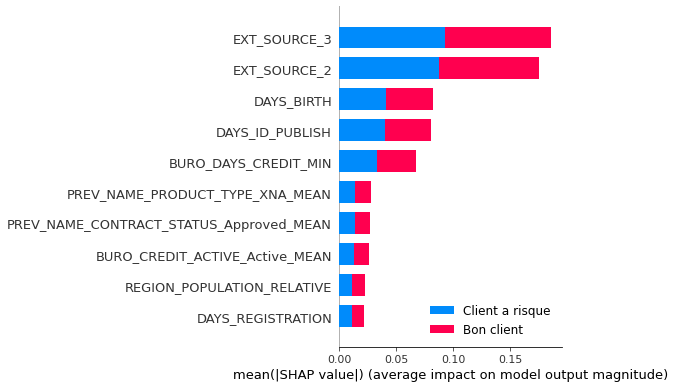

In [104]:
shap.initjs()
shap.summary_plot(shap_values,
                  subsampled_test_data,
                  feature_names=feature_names,
                  class_names=target_names,
                  max_display=10)

**Un autre client**

In [108]:
idx_ = random.randint(1, len(X_valid_std))
print("Actual :     ", target_names[int(np.array(Y_valid.TARGET)[idx_])])

Actual :      Bon client


In [109]:
df_idx_ = pd.DataFrame(X_valid_std[idx_].reshape(1,-1), columns=feature_names)
df_idx_

,EXT_SOURCE_2,PREV_DAYS_DECISION_MEAN,BURO_MONTHS_BALANCE_SIZE_MEAN,DAYS_REGISTRATION,PREV_NAME_YIELD_GROUP_low_normal_MEAN,PREV_NAME_YIELD_GROUP_high_MEAN,REGION_POPULATION_RELATIVE,PREV_NAME_PAYMENT_TYPE_Cashthroughthebank_MEAN,BURO_DAYS_CREDIT_MAX,POS_MONTHS_BALANCE_MEAN,...,BURO_DAYS_CREDIT_MEAN,DAYS_BIRTH,BURO_CREDIT_ACTIVE_Active_MEAN,ACTIVE_DAYS_CREDIT_MAX,PREV_NAME_CONTRACT_STATUS_Approved_MEAN,DAYS_LAST_PHONE_CHANGE,REFUSED_DAYS_DECISION_MAX,ACTIVE_DAYS_CREDIT_MEAN,PREV_DAYS_DECISION_MIN,DAYS_ID_PUBLISH
0,0.957133,0.335889,-0.088329,0.482292,0.477159,-0.815244,1.838047,-0.053872,0.324242,0.321038,...,0.053748,-1.343978,-0.113505,0.280232,-0.333348,0.470115,0.336039,0.191647,-0.025956,-1.353961


In [110]:
current_model = trained_models[1] # Explain the lgbm Model
print("Classifieur : ",  current_model["name"])
print("Prediction : ", target_names[int(current_model["model"].predict(X_valid_std[idx_].reshape(1,-1))[0])])

sub_sampled_train_data = shap.sample(X_train_std, 600, random_state=0) # use 600 samples of train data as background data

sub_sampled_test_data =X_valid_std[idx_].reshape(1,-1)

start_time = time.time()
explainer = shap.KernelExplainer(current_model["model"].predict_proba, sub_sampled_train_data)

shap_values = explainer.shap_values(subsampled_test_data,  l1_reg="aic")

elapsed_time = time.time() - start_time
# explain first sample from test data
print("Kernel Explainer SHAP run time", round(elapsed_time,3) , " seconds. ", current_model["name"])
print("SHAP expected value", explainer.expected_value)
print("Model mean value", current_model["model"].predict_proba(X_train_std).mean(axis=0))
print("Model prediction for test data", current_model["model"].predict_proba(subsampled_test_data))
shap.initjs()
pred_ind = 0
shap.force_plot(explainer.expected_value[1], shap_values[1][0], sub_sampled_test_data[0], feature_names=feature_names)

Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
Using 600 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


Classifieur :  LGBM
Prediction :  Bon client


  0%|          | 0/1 [00:00<?, ?it/s]

Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.


Kernel Explainer SHAP run time 13.99  seconds.  LGBM
SHAP expected value [0.57910801 0.42089199]
Model mean value [0.58982127 0.41017873]
Model prediction for test data [[0.80497835 0.19502165]]


Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.


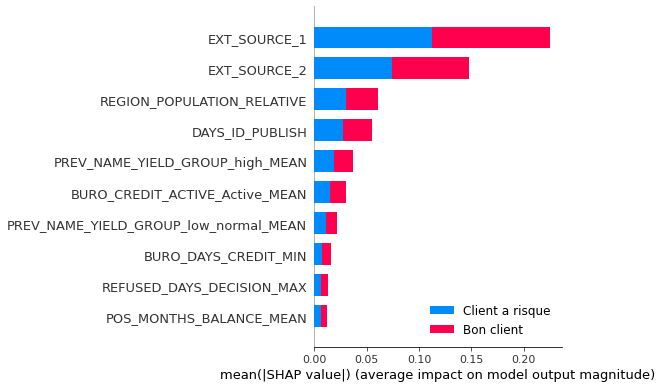

In [111]:
shap.initjs()
shap.summary_plot(shap_values,
                  subsampled_test_data,
                  feature_names=feature_names,
                  class_names=target_names,
                  max_display=10)

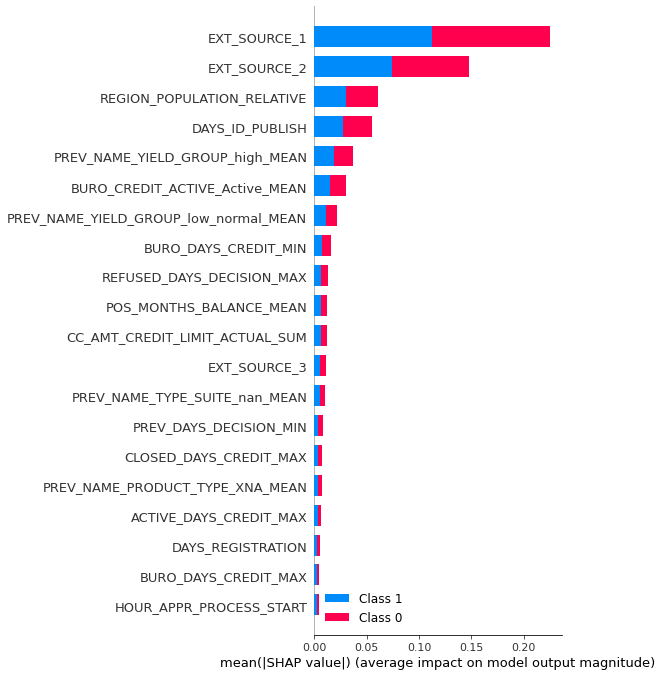

In [140]:
shap.initjs()
shap.summary_plot(shap_values, X_valid_std, feature_names=feature_names)

In [145]:
# explain the model's predictions on test set using SHAP values
# same syntax works for xgboost, LightGBM, CatBoost, and some scikit-learn models
explainer = shap.TreeExplainer(trained_models[1]["model"])   # Explain the lgbm Model

# shap_values consists of a list of two matrices of dimension samplesize x #features
# The first matrix uses average nr of benign samples as base value
# The second matrix which is used below uses average nr of malignant samples as base value 
shap_values = explainer.shap_values(X_valid_std)


# Interactive visualization of the explanation of the first subject
# in the test set (X_explain).
# It shows the relative contribution of features to get from the base value of malignant
# samples(average value)
# to the output value (1 in case of malignant sample)
# the numbers at the bottom show the actual values for this sample.
shap.initjs() #initialize javascript in cell
shap.force_plot(explainer.expected_value[1], shap_values[1][0,:], X_valid_std[0,:], feature_names=feature_names)

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


In [170]:
#Interactive visualization of all sample/feature Shapley values
#It is possible to show the relative contribution of individual features for all
# samples on the y-axis as well.
shap_values = explainer.shap_values(X_valid_std[:500, :])
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1], X_valid_std[:500, :], feature_names=feature_names)

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


In [174]:
Y_valid.TARGET[:500].value_counts()

0.0    459
1.0     41
Name: TARGET, dtype: int64

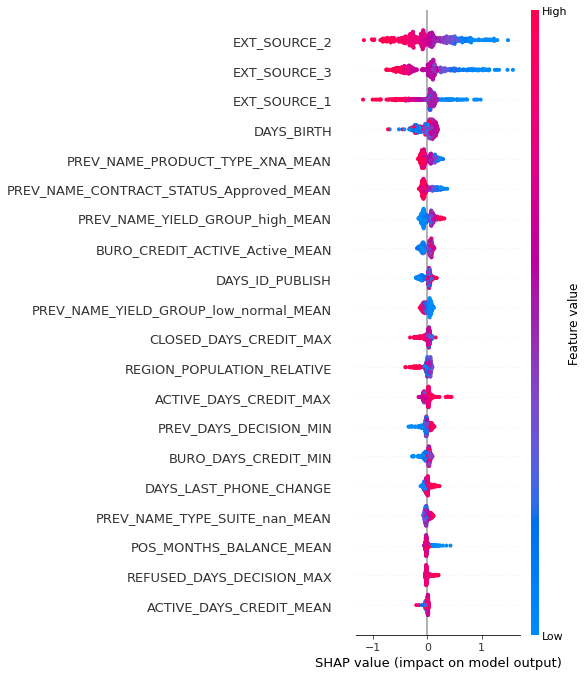

In [175]:
#A summary plot with the shapley value (feature importance) 
shap.summary_plot(shap_values[1],  X_valid_std[:500, :], feature_names=feature_names)

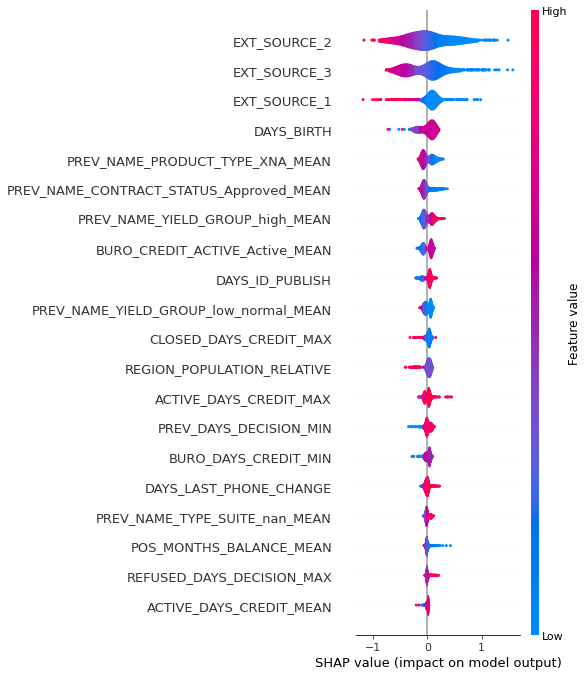

In [176]:
#Same as above, but with violin plots to better see the distribution of shapley values 
shap.summary_plot(shap_values[1], X_valid_std[:500, :], feature_names=feature_names, plot_type="violin")

Très corrélées à la classe 0 c-a-d 'Bon client':   
* **Ext_source_1**: Normalized score from external data source
* **Ext_source_2**: Normalized score from external data source
* **Ext_source_3**: Normalized score from external data source
* **PREV_NAME_CONTRACT_STATUS_Approved_MEAN**: (La moyenne de nombre de crédit accordée) 

Très corrélées à la classe 1 c-a-d 'Client à risque':  
* **DAYS_BIRTH**: (l'age du client)  

**LogisticRegression**

In [293]:
#idx = random.randint(1, len(X_valid_std))
idx = 22643
print(idx)
print("Actual :     ", target_names[int(np.array(Y_valid.TARGET)[idx])])
df_idx = pd.DataFrame(X_valid_std[idx].reshape(1,-1), columns=feature_names)
df_idx

22643
Actual :      Bon client


,EXT_SOURCE_2,PREV_DAYS_DECISION_MEAN,BURO_MONTHS_BALANCE_SIZE_MEAN,DAYS_REGISTRATION,PREV_NAME_YIELD_GROUP_low_normal_MEAN,PREV_NAME_YIELD_GROUP_high_MEAN,REGION_POPULATION_RELATIVE,PREV_NAME_PAYMENT_TYPE_Cashthroughthebank_MEAN,BURO_DAYS_CREDIT_MAX,POS_MONTHS_BALANCE_MEAN,...,BURO_DAYS_CREDIT_MEAN,DAYS_BIRTH,BURO_CREDIT_ACTIVE_Active_MEAN,ACTIVE_DAYS_CREDIT_MAX,PREV_NAME_CONTRACT_STATUS_Approved_MEAN,DAYS_LAST_PHONE_CHANGE,REFUSED_DAYS_DECISION_MAX,ACTIVE_DAYS_CREDIT_MEAN,PREV_DAYS_DECISION_MIN,DAYS_ID_PUBLISH
0,-0.052664,0.780184,-0.694859,1.210508,-0.761228,0.936074,-0.306837,-1.189689,0.827293,0.944912,...,0.673439,1.493454,-0.551107,0.803702,-0.985661,0.3091,-0.003497,1.139192,0.986274,0.53559


In [307]:
current_model = trained_models[0] # Explain the LogisticRegression
print("Classifieur : ",  current_model["name"])
print("Prediction : ", target_names[int(current_model["model"].predict(X_valid_std[idx].reshape(1,-1))[0])])
sub_sampled_train_data = shap.sample(X_train_std, 600, random_state=0) # use 600 samples of train data as background data

subsampled_test_data =X_valid_std[idx].reshape(1,-1)

start_time = time.time()
explainer = shap.KernelExplainer(current_model["model"].predict_proba, sub_sampled_train_data)
shap_values = explainer.shap_values(subsampled_test_data,  l1_reg="aic")
elapsed_time = time.time() - start_time
# explain first sample from test data
print("Kernel Explainer SHAP run time", round(elapsed_time,3) , " seconds. ", current_model["name"])
print("SHAP expected value", explainer.expected_value)
print("Model mean value", current_model["model"].predict_proba(X_train_std).mean(axis=0))
print("Model prediction for test data", current_model["model"].predict_proba(subsampled_test_data))
shap.initjs()
pred_ind = 0
shap.force_plot(explainer.expected_value[1], shap_values[1][0], subsampled_test_data[0], feature_names=feature_names)

Classifieur :  LR
Prediction :  Client a risque


Using 600 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/1 [00:00<?, ?it/s]

Kernel Explainer SHAP run time 7.3  seconds.  LR
SHAP expected value [0.55566502 0.44433498]
Model mean value [0.5673381 0.4326619]
Model prediction for test data [[0.16455304 0.83544696]]


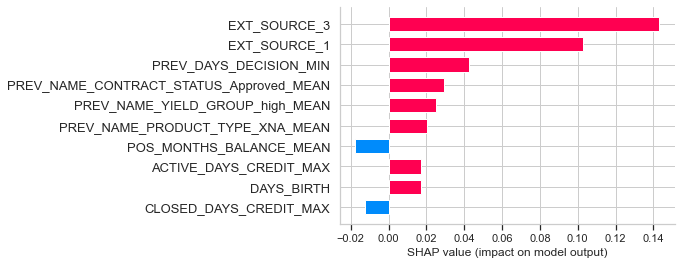

In [325]:
shap.bar_plot(shap_values[1][0], feature_names=feature_names, max_display=10)

In [333]:
explainer = lime_tabular.LimeTabularExplainer(X_train_std, mode="classification",
                                              class_names=['Bon client', 'Client a risque'],
                                              feature_names=feature_names,
                                             )

explainer

In [334]:
print("Classifieur : ",  current_model["name"])
print("Prediction : ", target_names[int(current_model["model"].predict(X_valid_std[idx].reshape(1,-1))[0])])
explanation = explainer.explain_instance(X_valid_std[idx], current_model["model"].predict_proba, num_features=10)
explanation.show_in_notebook()

Classifieur :  LR
Prediction :  Client a risque


# Résumé

In [244]:
def Custom_score(y_true, y_pred):
    # coût d'un faux positif et un faux négatif
    cout_fp = 1
    cout_fn = 10
    
    # nombre total d'exemples positifs et négatifs
    n_pos = (y_true==1).sum()
    n_neg = (y_true==0).sum()
    # calcul du coût maximum possible
    max_cout = cout_fp * n_neg + cout_fn * n_pos
    
    # Calcul du nombre de faux positifs et faux négatifs
    fp = ((y_pred == 1) & (y_true == 0)).sum()
    fn = ((y_pred == 0) & (y_true == 1)).sum()
    
    # calcul du coût total    
    cout = (cout_fp * fp + cout_fn * fn)  # / (fn + fp)
    cout_notmalise = cout/max_cout
    score = round(1 - cout_notmalise, 2)
    return score

custom_score = make_scorer(Custom_score, greater_is_better=True)

In [256]:
def model_eval_score(model, Xval, yval):
    
    yval_pred = model.predict(Xval)
    
    metrics = {'AUROC_score': round(roc_auc_score(yval, model.predict_proba(Xval)[:, 1]), 2),
               'Costum_score': round(Custom_score(yval, yval_pred), 2),
               'f_beta_score': round(fbeta_score(yval, yval_pred, beta=3.16), 2),
               'Accuracy_score': round(accuracy_score(yval, yval_pred), 2),
               'Recall_score': round(recall_score(yval, yval_pred), 2),
               'Presicion_score': round(precision_score(yval, yval_pred), 2)}

    for key, val in metrics.items():
        print(key + ' : ' + str(val))
    print('conf_mat : \n' + str(confusion_matrix(yval, yval_pred)))
    print() 

In [ ]:
df = pd.read_csv('data/traited/df_train_35.csv') 

In [262]:
start_time = timeit.default_timer()
model_lr = LogisticRegression(solver='lbfgs', class_weight='balanced').fit(X_train_std, Y_train)
print("Time: ", round(timeit.default_timer() - start_time,2))

Time:  1.37


In [213]:
y_valid = np.array(Y_valid.TARGET)

In [257]:
print("Modèle LogisticRegression: ")
model_eval_score(model_lr, X_valid_std, y_valid)

Modèle LogisticRegression: 
AUROC_score : 0.73
Costum_score : 0.67
f_beta_score : 0.5
Accuracy_score : 0.68
Recall_score : 0.65
Presicion_score : 0.15
conf_mat : 
[[63851 29457]
 [ 2853  5317]]



In [263]:
start_time = timeit.default_timer()
model_baseline = DummyClassifier(strategy='most_frequent').fit(X_train_std, Y_train)
print("Time: ", round(timeit.default_timer() - start_time,2))

Time:  0.01


In [259]:
print("Modèle baseline: ")
model_eval_score(model_baseline, X_valid_std, y_valid)

Modèle baseline: 
AUROC_score : 0.5
Costum_score : 0.53
f_beta_score : 0.0
Accuracy_score : 0.92
Recall_score : 0.0
Presicion_score : 0.0
conf_mat : 
[[93308     0]
 [ 8170     0]]



Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


In [264]:
start_time = timeit.default_timer()
model_lgbm = LGBMClassifier(n_estimators=500, max_depth=8, learning_rate=0.02, class_weight='balanced').fit(X_train_std, Y_train)
print("Time: ", round(timeit.default_timer() - start_time,2))

Time:  9.78


In [261]:
print("Modèle LGBM: ")
model_eval_score(model_lgbm, X_valid_std, y_valid)

Modèle LGBM: 
AUROC_score : 0.74
Costum_score : 0.68
f_beta_score : 0.51
Accuracy_score : 0.7
Recall_score : 0.65
Presicion_score : 0.16
conf_mat : 
[[65414 27894]
 [ 2820  5350]]

